# Подключение основных библиотек

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import ccxt
from IPython.display import clear_output, display

#sns.set_theme()
%matplotlib inline

In [2]:
import random

random.seed(0)
np.random.seed()

# Получение данных о котировке BTC/USDT c биржи OKX

## Считывание данных с биржи

In [3]:
# Биржа из которой будут браться данные с помощью CCXT
EXCHANGE = ccxt.okx()
# Инструмент в формате символа для обработки
SYMBOL = "BTC/USDT"
# Таймфрейм свеч
TIMEFRAME = "1h"

In [4]:
from_ts = EXCHANGE.parse8601('2018-01-10 00:00:00')

ohlcv_list = []
ohlcv = EXCHANGE.fetch_ohlcv(symbol=SYMBOL, timeframe=TIMEFRAME, since=from_ts, limit=100)
ohlcv_list.append(ohlcv)

while True:
    from_ts = ohlcv[-1][0]
    new_ohlcv = EXCHANGE.fetch_ohlcv(symbol=SYMBOL, timeframe=TIMEFRAME, since=from_ts, limit=100)
    ohlcv.extend(new_ohlcv)

    print(f"\r{EXCHANGE.iso8601(from_ts)}", end="")
    
    if len(new_ohlcv) <= 1:
    	break

2024-09-29T11:00:00.000Z

In [5]:
ohlcv = pd.DataFrame(ohlcv, columns=["Date", "Open", "High", "Low", "Close", "Volume"])
ohlcv["Date"] = ohlcv["Date"].apply(lambda x: datetime.datetime.fromtimestamp(x / 1000))

In [6]:
ohlcv

,Date,Open,High,Low,Close,Volume
0,2018-01-11 11:00:00,13356.7,13554.5,13133.5,13463.5,399.179267
1,2018-01-11 12:00:00,13467.0,13891.5,13454.9,13806.3,443.203516
2,2018-01-11 13:00:00,13806.3,13868.1,13668.7,13784.2,375.978845
3,2018-01-11 14:00:00,13785.8,13970.9,13680.3,13969.7,450.622312
4,2018-01-11 15:00:00,13977.6,14284.0,13868.1,13983.5,542.888459
...,...,...,...,...,...,...
59464,2024-09-29 09:00:00,65560.9,65690.0,65556.7,65582.6,85.416750
59465,2024-09-29 09:00:00,65560.9,65690.0,65556.7,65582.6,85.416750
59466,2024-09-29 10:00:00,65582.0,65588.0,65460.0,65575.6,78.203406
59467,2024-09-29 11:00:00,65575.7,65668.0,65566.2,65650.0,73.520450


In [7]:
ohlcv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59469 entries, 0 to 59468
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    59469 non-null  datetime64[ns]
 1   Open    59469 non-null  float64       
 2   High    59469 non-null  float64       
 3   Low     59469 non-null  float64       
 4   Close   59469 non-null  float64       
 5   Volume  59469 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 2.7 MB


## Удаление дубликатов данных

In [8]:
ohlcv = ohlcv.drop_duplicates()

In [9]:
ohlcv.shape

(58874, 6)

## Поиск отсутсвующих значений

In [10]:
ohlcv.isna().sum()

Date      0
Open      0
High      0
Low       0
Close     0
Volume    0
dtype: int64

# Анализ данных данных

In [11]:
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.gofplots import qqplot
from scipy.stats import t

In [12]:
ohlc = ohlcv[["Open", "High", "Low", "Close"]]
returns = ohlcv["Close"].diff()
log_returns = np.log(ohlcv["Close"]).diff()
ptc_returns = ohlcv["Close"].pct_change()

## Линейная визуализация

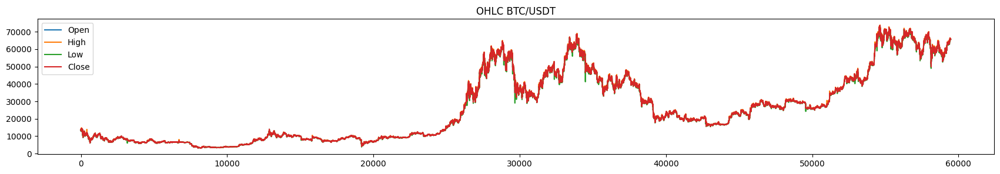

In [13]:
ohlc.plot(figsize=(21, 3), title="OHLC BTC/USDT")
plt.show()

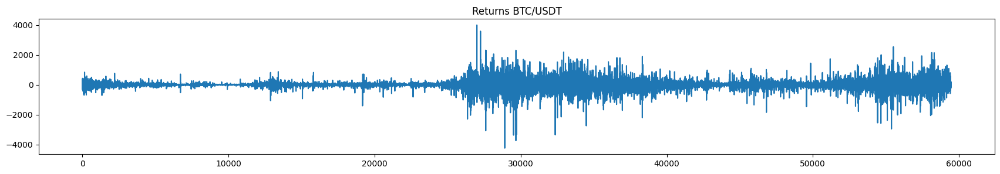

In [14]:
returns.plot(figsize=(21, 3), title="Returns BTC/USDT")
plt.show()

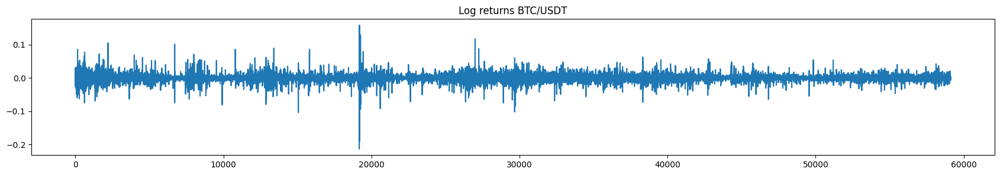

In [20]:
log_returns.plot(figsize=(21, 3), title="Log returns BTC/USDT")
plt.show()

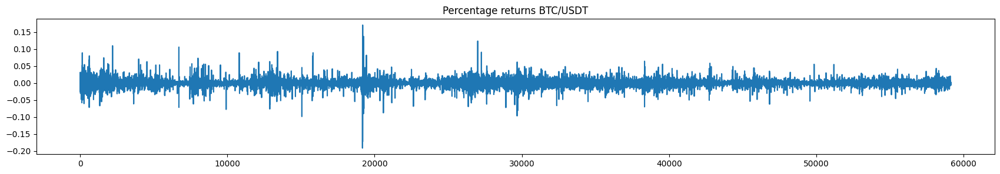

In [21]:
ptc_returns.plot(figsize=(21, 3), title="Percentage returns BTC/USDT")
plt.show()

## Гистограммы данных

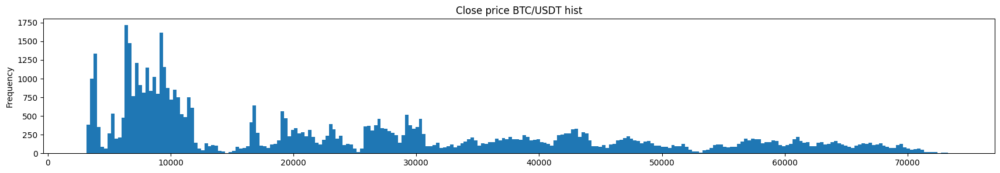

Close Mean: 25795.09873084741
Close STD: 19382.996554475998
Close Skew: 0.7059209192966268
Close Kurtosis: -0.7286872038735361
Close Excess kurtosis: -3.728687203873536


In [22]:
ohlc["Close"].plot(kind="hist", figsize=(21, 3), title="Close price BTC/USDT hist", bins=250)
plt.show()

print(f"Close Mean: {ohlc['Close'].mean()}")
print(f"Close STD: {ohlc['Close'].std()}")
print(f"Close Skew: {ohlc['Close'].skew()}")
print(f"Close Kurtosis: {ohlc['Close'].kurtosis()}")
print(f"Close Excess kurtosis: {ohlc['Close'].kurtosis() - 3}")

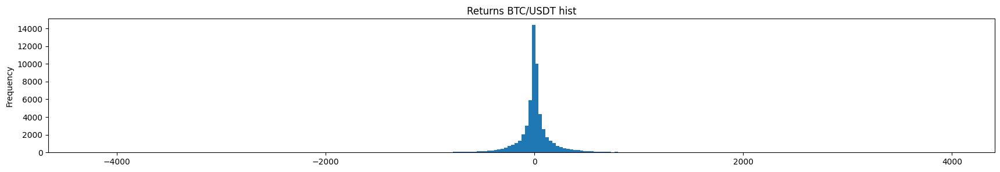

Returns Mean: 0.7923712889891018
Returns STD: 221.49152605782388
Returns Skew: -0.45874355655322696
Returns Kurtosis: 26.748338509627864
Returns Excess kurtosis: 23.748338509627864


In [23]:
returns.plot(kind="hist", figsize=(21, 3), title="Returns BTC/USDT hist", bins=250)
plt.show()

print(f"Returns Mean: {returns.mean()}")
print(f"Returns STD: {returns.std()}")
print(f"Returns Skew: {returns.skew()}")
print(f"Returns Kurtosis: {returns.kurtosis()}")
print(f"Returns Excess kurtosis: {returns.kurtosis() - 3}")

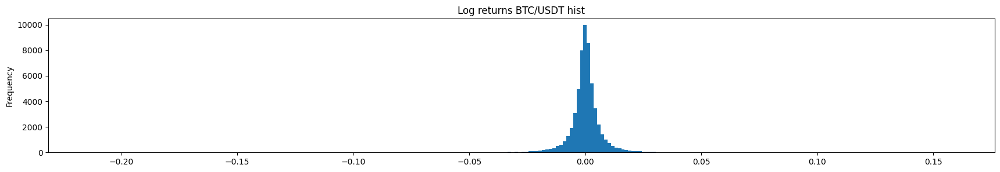

Log returns Mean: 2.5483711968425577e-05
Log returns STD: 0.007545993219684796
Log returns Skew: -0.5614975620634002
Log returns Kurtosis: 40.60410287863911
Log returns Excess kurtosis: 37.60410287863911


In [24]:
log_returns.plot(kind="hist", figsize=(21, 3), title="Log returns BTC/USDT hist", bins=250)
plt.show()

print(f"Log returns Mean: {log_returns.mean()}")
print(f"Log returns STD: {log_returns.std()}")
print(f"Log returns Skew: {log_returns.skew()}")
print(f"Log returns Kurtosis: {log_returns.kurtosis()}")
print(f"Log returns Excess kurtosis: {log_returns.kurtosis() - 3}")

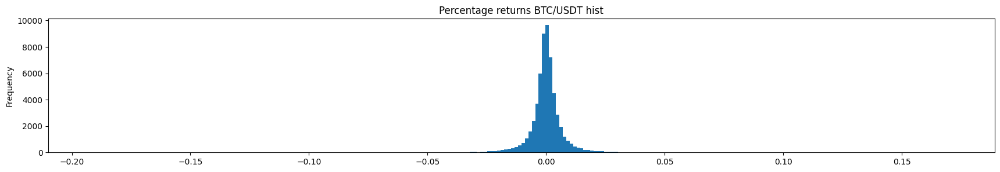

Log returns Mean: 5.3920887484071135e-05
Log returns STD: 0.007535460718321911
Log returns Skew: -0.1024653616855763
Log returns Kurtosis: 36.79891629466352
Log returns Excess kurtosis: 33.79891629466352


In [25]:
ptc_returns.plot(kind="hist", figsize=(21, 3), title="Percentage returns BTC/USDT hist", bins=250)
plt.show()

print(f"Log returns Mean: {ptc_returns.mean()}")
print(f"Log returns STD: {ptc_returns.std()}")
print(f"Log returns Skew: {ptc_returns.skew()}")
print(f"Log returns Kurtosis: {ptc_returns.kurtosis()}")
print(f"Log returns Excess kurtosis: {ptc_returns.kurtosis() - 3}")

## Box plot

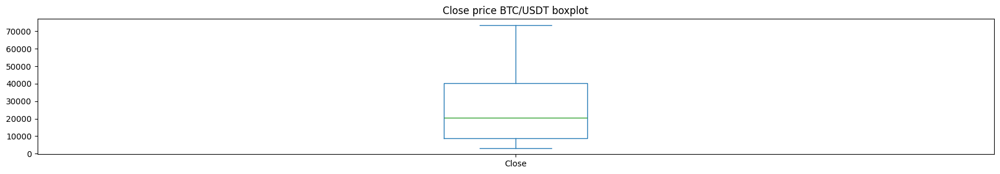

In [26]:
ohlc["Close"].plot(kind="box", figsize=(21, 3), title="Close price BTC/USDT boxplot")
plt.show()

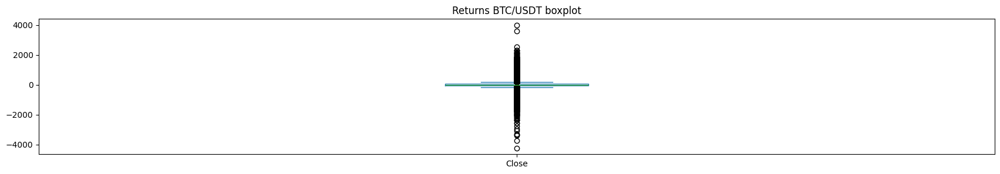

In [27]:
returns.plot(kind="box", figsize=(21, 3), title="Returns BTC/USDT boxplot")
plt.show()

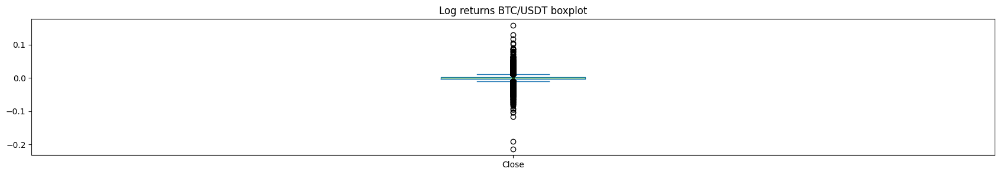

In [28]:
log_returns.plot(kind="box", figsize=(21, 3), title="Log returns BTC/USDT boxplot")
plt.show()

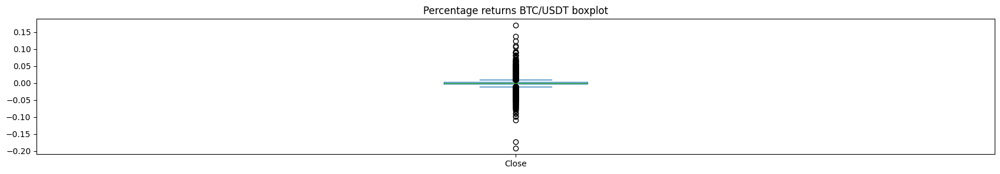

In [29]:
ptc_returns.plot(kind="box", figsize=(21, 3), title="Percentage returns BTC/USDT boxplot")
plt.show()

## Проверка нормальности и стационарности Log returns BTC/USDT

In [30]:
def adf_test(series):
    result = adfuller(series)
    print("ADF Test:")
    print(f"\tADF Statistic: {result[0]}")
    print(f"\tp-value: {result[1]}")
    for key, value in result[4].items():
        print(f"\tCritical Value {key}: {value}")
    if result[1] < 0.05:
        print("\tВременной ряд стационарен (отвергаем H0)\n")
    else:
        print("\tВременной ряд не стационарен (не отвергаем H0)\n")

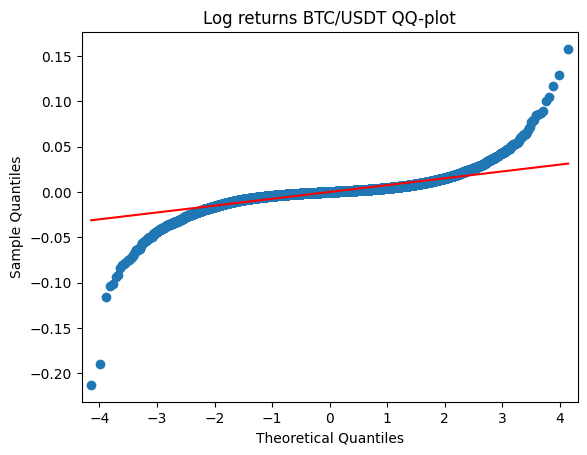

ADF Test:
	ADF Statistic: -33.8200787471934
	p-value: 0.0
	Critical Value 1%: -3.4304618069244732
	Critical Value 5%: -2.8615894165224853
	Critical Value 10%: -2.56679630275304
	Временной ряд стационарен (отвергаем H0)



In [31]:
qqplot(log_returns.dropna(), line="s")
plt.title("Log returns BTC/USDT QQ-plot")
plt.show()

adf_test(log_returns.dropna())

## Подбор параметров для подгонки распределения Log returns под t-распределение  Стьюдента

In [32]:
# Подгонка данных
df, loc, scale = t.fit(log_returns.dropna())

In [33]:
print(f"Степень свободы: {df}")
print(f"Среднее: {loc}")
print(f"Стандартное отклонение: {scale}")

Степень свободы: 1.953239754174249
Среднее: 9.106477797492977e-05
Стандартное отклонение: 0.003203741131268344


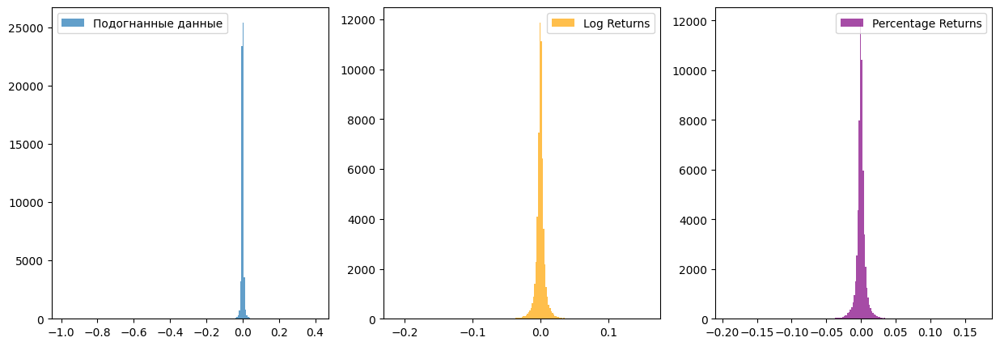

In [34]:
# Генерируйте случайные числа из t-распределения:
random_samples = t.rvs(df, loc=loc, scale=scale, size=log_returns.shape[0])

fig, ax = plt.subplots(ncols=3, figsize=(15, 5))
ax[0].hist(random_samples, bins=200, alpha=0.7, label='Подогнанные данные')
ax[0].legend()
ax[1].hist(log_returns, bins=200, alpha=0.7, color="orange", label='Log Returns')
ax[1].legend()
ax[2].hist(ptc_returns, bins=200, alpha=0.7, color="purple", label='Percentage Returns')
ax[2].legend()
plt.show()

## Визуализации распределения

In [35]:
from scipy import stats

/tmp/ipykernel_59626/763094357.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(returns, norm_hist=True, fit=stats.norm,


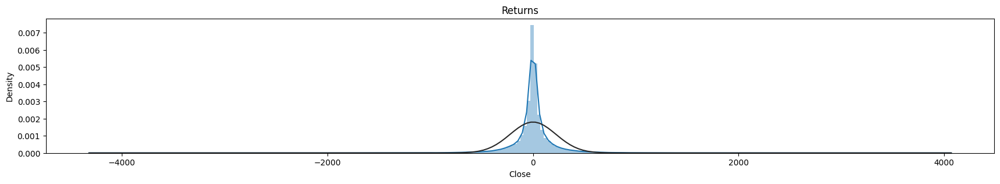

In [36]:
fig, ax = plt.subplots(figsize=(21,3))
sns.distplot(returns, norm_hist=True, fit=stats.norm, 
             bins=250, ax=ax)
ax.set_title('Returns')
plt.show()

/tmp/ipykernel_59626/1373788659.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(log_returns, norm_hist=True, fit=stats.norm,


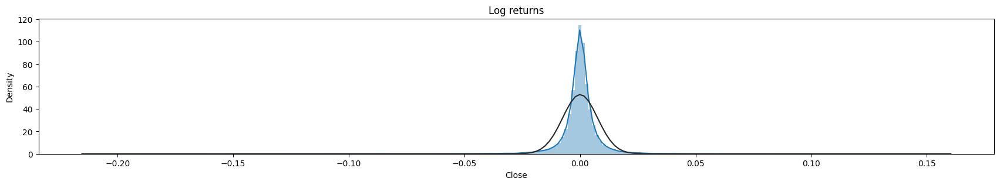

In [37]:
fig, ax = plt.subplots(figsize=(21,3))
sns.distplot(log_returns, norm_hist=True, fit=stats.norm, 
             bins=250, ax=ax)
ax.set_title('Log returns')
plt.show()

/tmp/ipykernel_59626/3482585300.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(ptc_returns, norm_hist=True, fit=stats.norm,


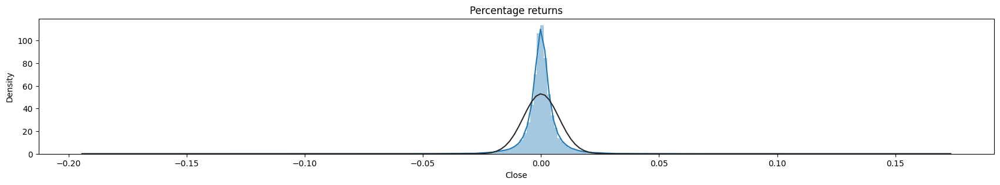

In [38]:
fig, ax = plt.subplots(figsize=(21,3))
sns.distplot(ptc_returns, norm_hist=True, fit=stats.norm, 
             bins=250, ax=ax)
ax.set_title('Percentage returns')
plt.show()

## ACF, PACF

In [39]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

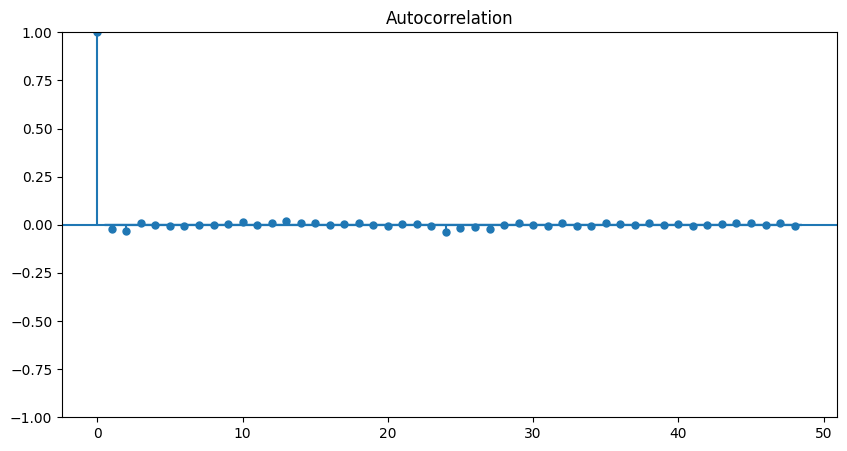

In [40]:
fig, ax = plt.subplots(figsize=(10, 5))
plot_acf(log_returns.dropna(), ax=ax)
plt.show()

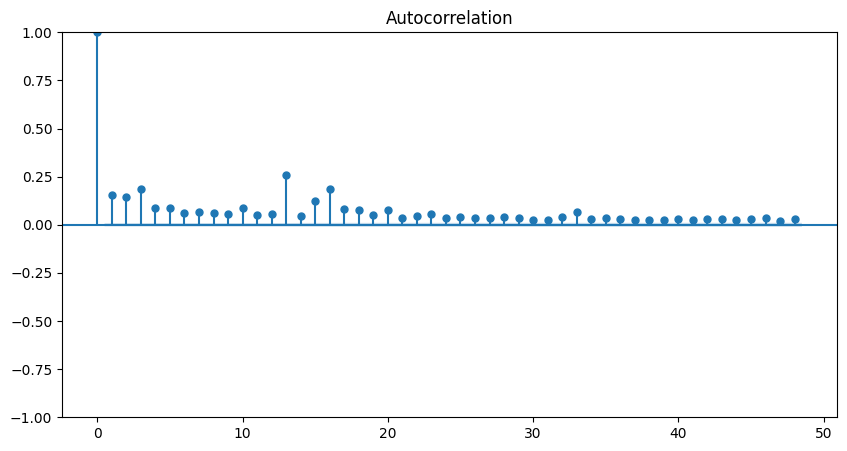

In [41]:
fig, ax = plt.subplots(figsize=(10, 5))
plot_acf(log_returns.dropna() ** 2, ax=ax)
plt.show()

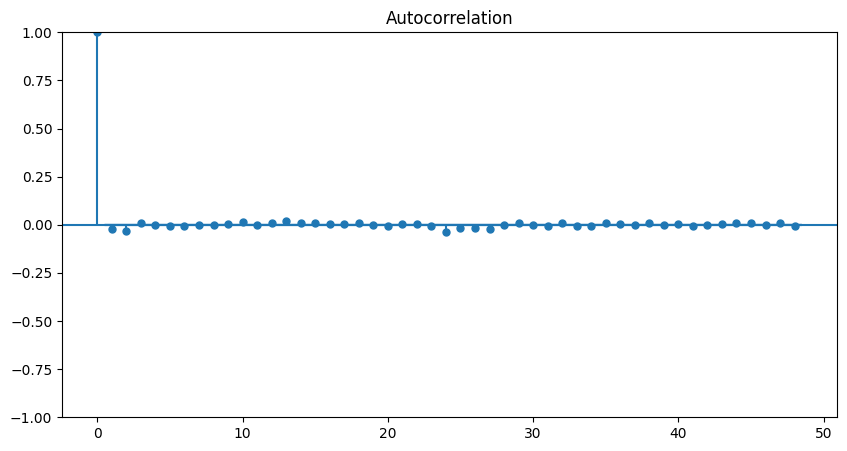

In [42]:
fig, ax = plt.subplots(figsize=(10, 5))
plot_acf(ptc_returns.dropna(), ax=ax)
plt.show()

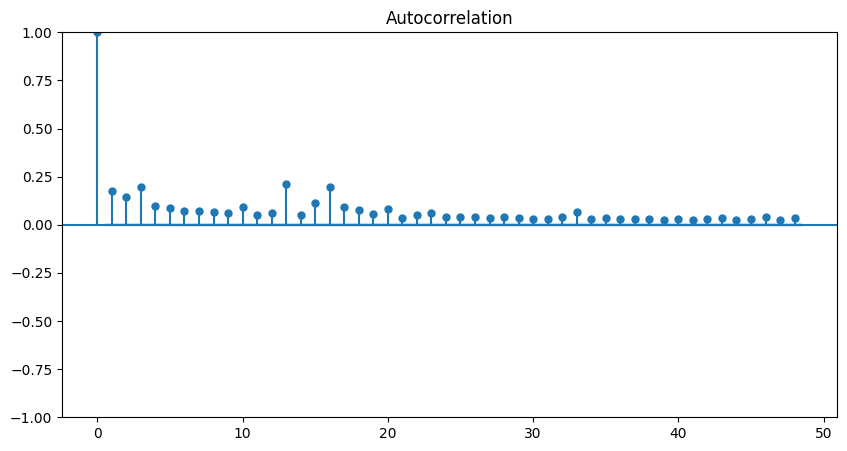

In [43]:
fig, ax = plt.subplots(figsize=(10, 5))
plot_acf(ptc_returns.dropna() ** 2, ax=ax)
plt.show()

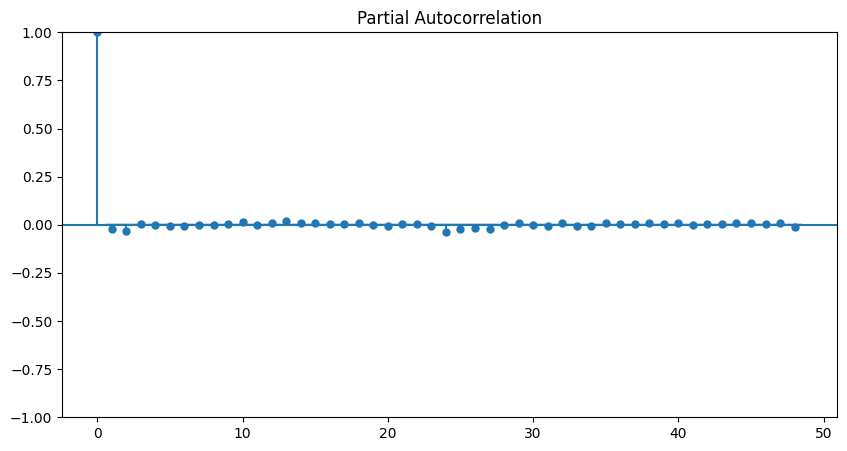

In [44]:
fig, ax = plt.subplots(figsize=(10, 5))
plot_pacf(log_returns.dropna(), ax=ax)
plt.show()

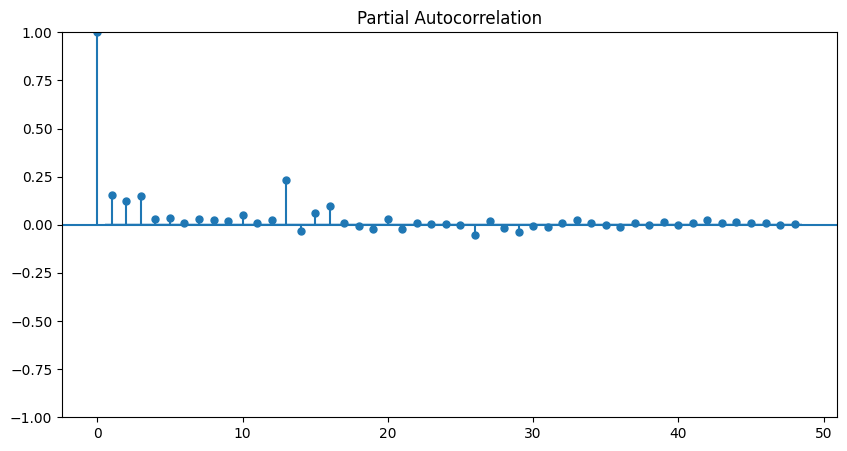

In [45]:
fig, ax = plt.subplots(figsize=(10, 5))
plot_pacf(log_returns.dropna() ** 2, ax=ax)
plt.show()

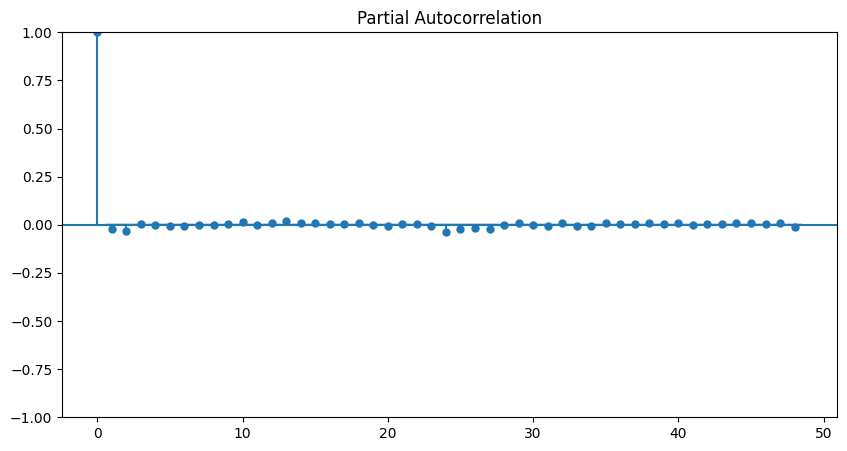

In [46]:
fig, ax = plt.subplots(figsize=(10, 5))
plot_pacf(ptc_returns.dropna(), ax=ax)
plt.show()

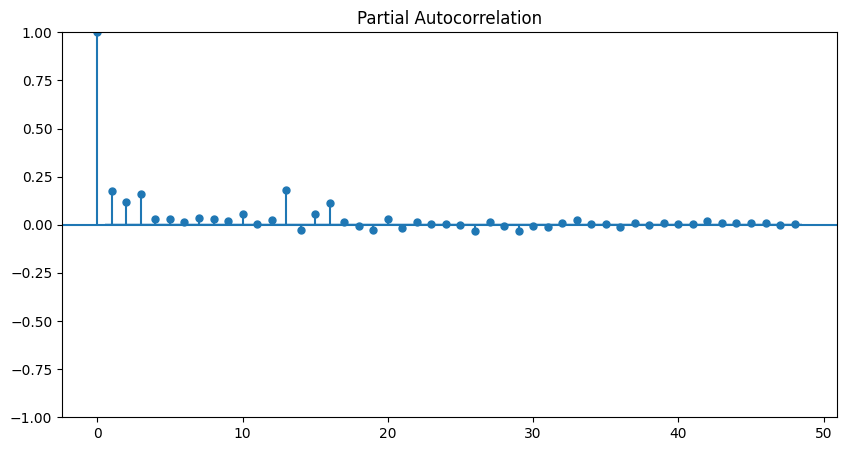

In [47]:
fig, ax = plt.subplots(figsize=(10, 5))
plot_pacf(ptc_returns.dropna() ** 2, ax=ax)
plt.show()

## Ljung-Box Test

Ho : Данные распределены независимо, автокорреляция отсутствует

Ha : Данные не являются независимо распределенными; в них наблюдается серийная корреляция

In [48]:
from statsmodels.stats.diagnostic import acorr_ljungbox

In [49]:
ljung_res = acorr_ljungbox(log_returns.dropna(), lags=50, boxpierce=True)
p = 0.05

ljung_res.head()

,lb_stat,lb_pvalue,bp_stat,bp_pvalue
1,28.373429,1.000288e-07,28.371975,1.001040e-07
2,82.291617,1.350835e-18,82.286479,1.354310e-18
3,85.438627,2.089305e-18,85.433220,2.094896e-18
4,85.445801,1.220082e-17,85.440394,1.223309e-17
5,86.682313,3.340654e-17,86.676757,3.349632e-17


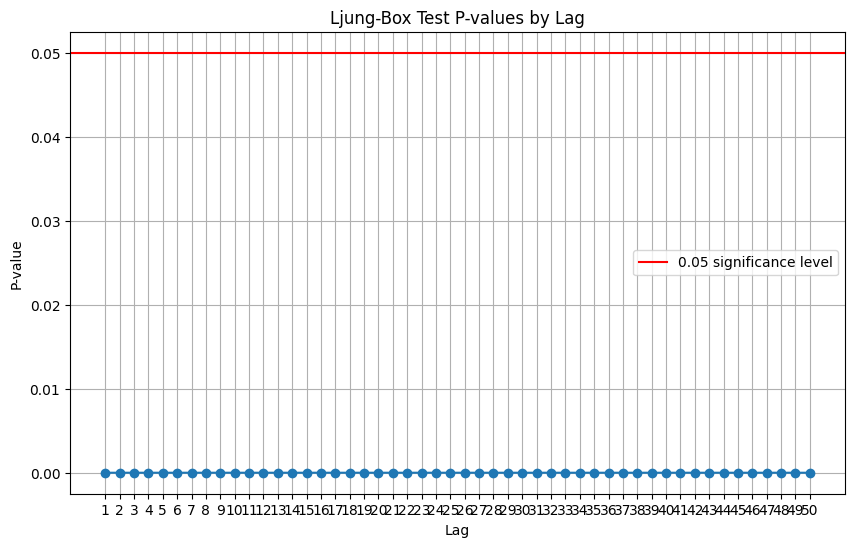

In [50]:
plt.figure(figsize=(10, 6))
plt.plot(ljung_res.index, ljung_res["lb_pvalue"], marker="o", linestyle="-")
plt.axhline(y=0.05, color="r", linestyle="-", label="0.05 significance level")
plt.title("Ljung-Box Test P-values by Lag")
plt.xlabel("Lag")
plt.ylabel("P-value")
plt.xticks(ticks=np.arange(1, 50 + 1))
plt.grid(True)
plt.legend()
plt.show()

Отклоняем нулевую гипотезу

## Вывод !TODO

# Моделирование

In [51]:
from statsforecast import StatsForecast
from statsforecast.models import ARCH, GARCH, Naive, AutoARIMA, AutoETS, AutoCES, AutoTheta, AutoTBATS
from mlforecast import MLForecast
from datasetsforecast import losses

from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
import lightgbm as lgb
import catboost

import optuna

In [52]:
import os
os.environ['NIXTLA_ID_AS_COL'] = '1'

## Создание датасетов

In [53]:
ohlcv["Return"] = ohlcv["Close"].diff()
ohlcv["LogReturn"] = np.log(ohlcv["Close"]).diff()
ohlcv["PctReturn"] = ohlcv["Close"].pct_change() * 100
ohlcv["Vol"] = ohlcv["Close"].rolling(24).std(ddof=0)

clear_output()

Убираем nan значения

In [54]:
ohlcv = ohlcv.dropna()

In [55]:
ohlcv

,Date,Open,High,Low,Close,Volume,Return,LogReturn,PctReturn,Vol
23,2018-01-12 10:00:00,13479.6,13955.0,13479.6,13908.2,457.132010,428.6,0.031301,3.179620,245.202125
24,2018-01-12 11:00:00,13906.6,14062.9,13817.6,13867.8,519.697591,-40.4,-0.002909,-0.290476,249.729712
25,2018-01-12 12:00:00,13867.8,13965.0,13582.7,13944.1,400.591613,76.3,0.005487,0.550195,255.744663
26,2018-01-12 13:00:00,13944.1,13946.0,13708.6,13766.1,398.854029,-178.0,-0.012847,-1.276526,255.265835
27,2018-01-12 14:00:00,13766.1,13826.9,13628.8,13803.1,373.836220,37.0,0.002684,0.268776,247.609590
...,...,...,...,...,...,...,...,...,...,...
59129,2024-09-15 13:00:00,60107.4,60367.1,60083.4,60184.6,156.917597,77.2,0.001284,0.128437,122.839673
59130,2024-09-15 14:00:00,60184.6,60290.5,59868.1,60275.8,146.429299,91.2,0.001514,0.151534,128.855281
59131,2024-09-15 15:00:00,60275.9,60407.3,60164.3,60334.2,150.169599,58.4,0.000968,0.096888,134.679946
59132,2024-09-15 16:00:00,60334.2,60354.0,59939.3,59955.9,159.330752,-378.3,-0.006290,-0.627008,135.577902


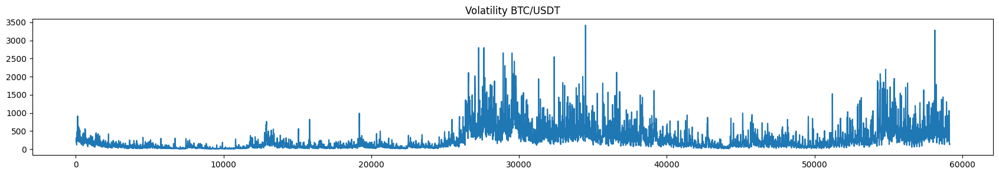

In [56]:
ohlcv["Vol"].plot(figsize=(21, 3))
plt.title("Volatility BTC/USDT")
plt.show()

### Унивариативный датасет для LogReturn

In [57]:
univariate_logreturn_nixtla_dataset = pd.DataFrame(
    columns = ["ds", "y", "unique_id"]   
)

univariate_logreturn_nixtla_dataset["ds"] = ohlcv["Date"]
univariate_logreturn_nixtla_dataset["y"] = ohlcv["PctReturn"]
univariate_logreturn_nixtla_dataset["unique_id"] = 1

In [58]:
univariate_logreturn_nixtla_dataset

,ds,y,unique_id
23,2018-01-12 10:00:00,3.179620,1
24,2018-01-12 11:00:00,-0.290476,1
25,2018-01-12 12:00:00,0.550195,1
26,2018-01-12 13:00:00,-1.276526,1
27,2018-01-12 14:00:00,0.268776,1
...,...,...,...
59129,2024-09-15 13:00:00,0.128437,1
59130,2024-09-15 14:00:00,0.151534,1
59131,2024-09-15 15:00:00,0.096888,1
59132,2024-09-15 16:00:00,-0.627008,1


In [59]:
train_logreturn_univariate = univariate_logreturn_nixtla_dataset[univariate_logreturn_nixtla_dataset["ds"] <= "2024-06-01"]
test_logreturn_univariate = univariate_logreturn_nixtla_dataset[univariate_logreturn_nixtla_dataset["ds"] > "2024-06-01"]

In [60]:
train_logreturn_univariate.shape, test_logreturn_univariate.shape

((55959, 3), (2561, 3))

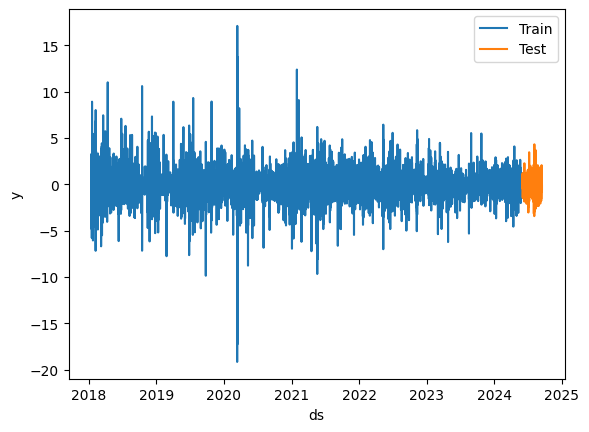

In [61]:
sns.lineplot(train_logreturn_univariate, x="ds", y="y", label="Train")
sns.lineplot(test_logreturn_univariate, x="ds", y="y", label="Test")
plt.show()

## Nixtla StatsForecast для прогнозирования LogReturn

In [228]:
season_length = 24 
horizon = len(test_univariate)

models = [
    AutoARIMA(season_length=1, alias="AutoARIMA 1"),
    AutoARIMA(season_length=12, alias="AutoARIMA 12"),
    AutoARIMA(season_length=24, alias="AutoARIMA 24"),
    AutoETS(season_length=1, alias="AutoETS 1"),
    AutoETS(season_length=12, alias="AutoETS 12"),
    AutoETS(season_length=24, alias="AutoETS 24"),
    #AutoCES(season_length=1, alias="AutoCES 1"),
    #AutoCES(season_length=12, alias="AutoCES 12"),
    #AutoCES(season_length=24, alias="AutoCES 24"),
    AutoTheta(season_length=1, alias="AutoTheta 1"),
    AutoTheta(season_length=12, alias="AutoTheta 12"),
    AutoTheta(season_length=24, alias="AutoTheta 24"),
    #AutoTBATS(season_length=1, alias="AutoTBATS 1"),
    #AutoTBATS(season_length=12, alias="AutoTBATS 12"),
    #AutoTBATS(season_length=24, alias="AutoTBATS 24"),
    ARCH(1), 
    ARCH(2),
    ARCH(12),
    ARCH(24),
    ARCH(48),
    GARCH(1,1),
    GARCH(1,3),
    GARCH(2,2),
    GARCH(3,1),
    GARCH(3,3),
    GARCH(12,12),
    GARCH(24,24),
    GARCH(48,48),
    
    Naive()    
]

In [229]:
sf = StatsForecast(#df=train_univariate,
                   models=models,
                   freq='h',
                   n_jobs=-1)

### Кросс валидация

In [230]:
crossvalidation_df = sf.cross_validation(df=train_logreturn_univariate.iloc[-5000:],
                                         h=50,
                                         step_size=10,
                                         n_windows=10)

In [231]:
crossvalidation_df

,unique_id,ds,cutoff,y,AutoARIMA 1,AutoARIMA 12,AutoARIMA 24,AutoETS 1,AutoETS 12,AutoETS 24,...,ARCH(48),"GARCH(1,1)","GARCH(1,3)","GARCH(2,2)","GARCH(3,1)","GARCH(3,3)","GARCH(12,12)","GARCH(24,24)","GARCH(48,48)",Naive
0,1,2024-05-26 05:00:00,2024-05-26 04:00:00,0.235140,0.0,0.019492,0.016812,0.015443,0.015443,0.015443,...,0.515134,0.574915,0.528090,0.561106,1.261922,0.528093,4.454909e+30,9.524949e+86,5.168510e+88,-0.136375
1,1,2024-05-26 06:00:00,2024-05-26 04:00:00,-0.054670,0.0,0.011384,0.016795,0.015443,0.015443,0.015443,...,-0.253098,-0.269323,-0.256179,-0.267563,-0.621906,-0.256181,-1.907882e+30,-4.168217e+86,-2.241430e+88,-0.136375
2,1,2024-05-26 07:00:00,2024-05-26 04:00:00,0.351063,0.0,-0.008041,-0.012833,0.015443,0.015443,0.015443,...,-0.198104,-0.224126,-0.200267,-0.207123,-0.443206,-0.200269,-1.712694e+30,-3.819357e+86,-2.050214e+88,-0.136375
3,1,2024-05-26 08:00:00,2024-05-26 04:00:00,-0.264323,0.0,-0.007123,-0.005505,0.015443,0.015443,0.015443,...,-0.406057,-0.435803,-0.379244,-0.421330,-0.866476,-0.379246,-3.606185e+30,-8.201194e+86,-4.395726e+88,-0.136375
4,1,2024-05-26 09:00:00,2024-05-26 04:00:00,-0.109450,0.0,-0.004136,-0.014888,0.015443,0.015443,0.015443,...,0.348827,0.375212,0.348204,0.364936,0.775761,0.348206,3.137696e+30,7.260451e+86,3.871492e+88,-0.136375
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,1,2024-05-31 20:00:00,2024-05-29 22:00:00,0.042257,0.0,-0.008066,-0.007413,0.014691,0.014691,0.014691,...,-0.273692,-0.296483,-0.476620,-0.268203,-0.301823,-0.264770,-1.463958e+32,-6.803155e+89,-6.879414e+101,-0.023488
496,1,2024-05-31 21:00:00,2024-05-29 22:00:00,-0.205140,0.0,0.002906,-0.008014,0.014691,0.014691,0.014691,...,0.075013,0.085335,0.144918,0.083933,0.086612,0.077260,4.608340e+31,2.171336e+89,2.201973e+101,-0.023488
497,1,2024-05-31 22:00:00,2024-05-29 22:00:00,-0.090424,0.0,0.005389,0.000775,0.014691,0.014691,0.014691,...,0.798169,0.862591,1.572140,0.828396,0.870955,0.852936,5.248807e+32,2.503075e+90,2.544787e+102,-0.023488
498,1,2024-05-31 23:00:00,2024-05-29 22:00:00,0.048437,0.0,-0.007818,-0.000546,0.014691,0.014691,0.014691,...,0.066506,0.068107,0.103639,0.067772,0.069775,0.068089,3.700979e+31,1.775377e+89,1.807372e+101,-0.023488


In [232]:
crossvalidation_df.columns

Index(['unique_id', 'ds', 'cutoff', 'y', 'AutoARIMA 1', 'AutoARIMA 12',
       'AutoARIMA 24', 'AutoETS 1', 'AutoETS 12', 'AutoETS 24', 'AutoTheta 1',
       'AutoTheta 12', 'AutoTheta 24', 'ARCH(1)', 'ARCH(2)', 'ARCH(12)',
       'ARCH(24)', 'ARCH(48)', 'GARCH(1,1)', 'GARCH(1,3)', 'GARCH(2,2)',
       'GARCH(3,1)', 'GARCH(3,3)', 'GARCH(12,12)', 'GARCH(24,24)',
       'GARCH(48,48)', 'Naive'],
      dtype='object')

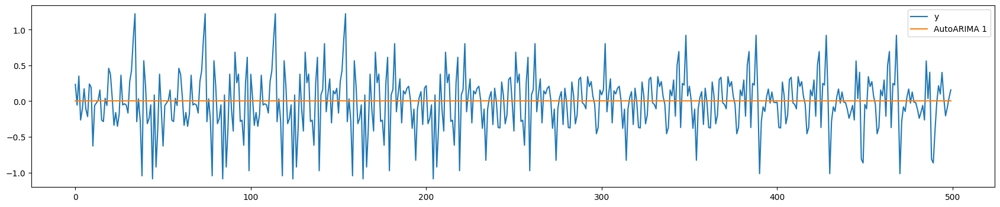

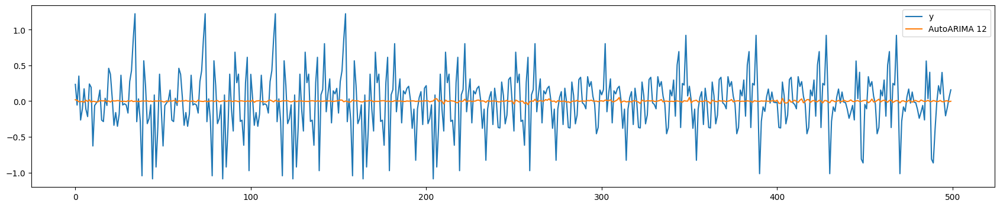

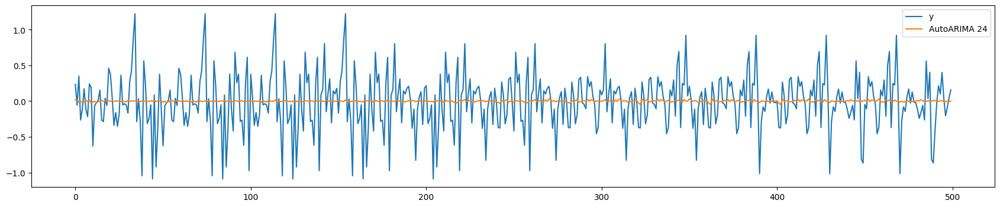

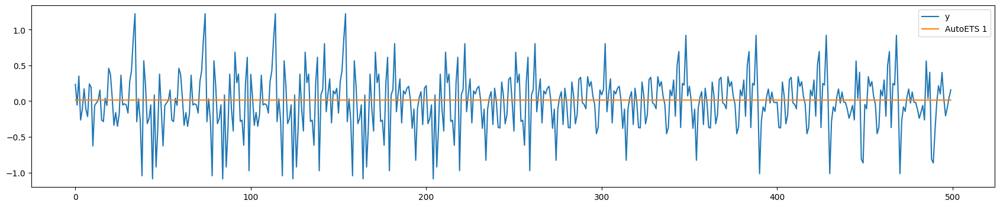

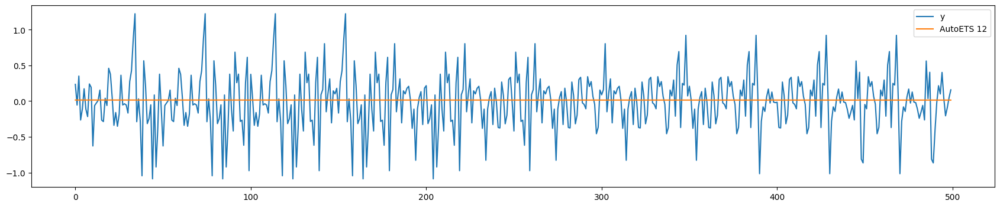

...

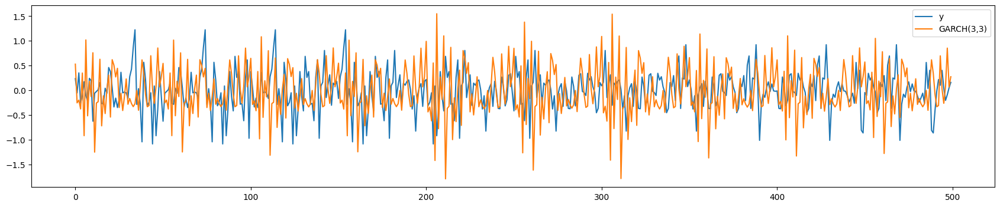

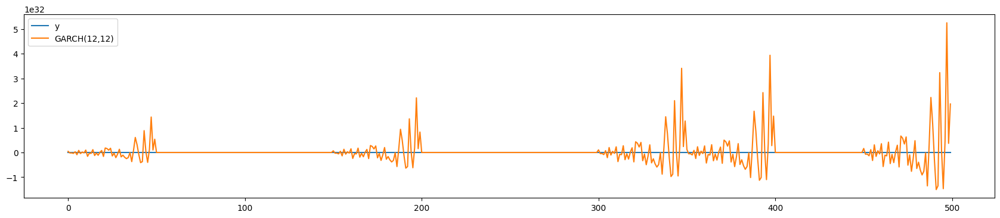

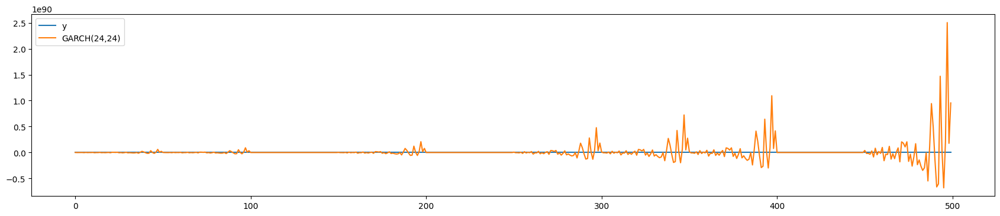

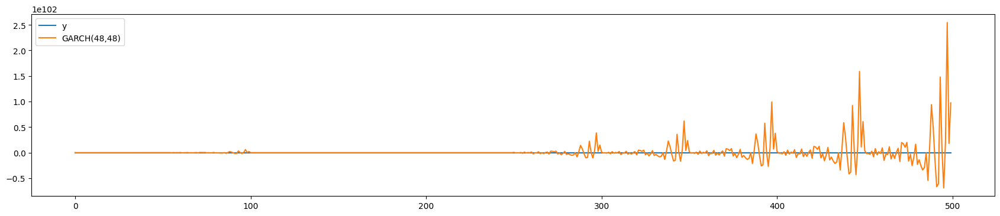

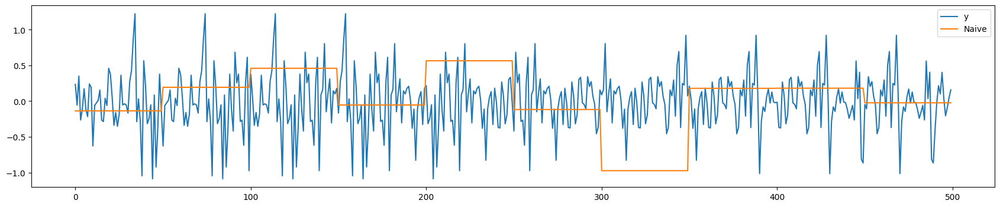

In [233]:
for i in crossvalidation_df.columns[4:]:
    crossvalidation_df.reset_index()[["y", i]].plot(figsize=(21, 4))
    plt.show()

В ARCH и GARCH моделт нельзя поставлять все точки данных, иначе прогноз будет сверх некорректным. Рекомендуется брать последние 200 - 300 точек данных. Лучше всего справляется ARCH модель с периодами: 18, 24, 36 на тренировочных данных. Остальные модели справились крайне плохо с прогнозом

### Оптимизация гиперпараметров на прошлых 5000 точек данных 

In [164]:
def objective(trial):
    model = trial.suggest_categorical("model", ["ARCH", "GARCH"])

    if model == "ARCH":
        p = trial.suggest_int("p", 1, 96)
        models = [ARCH(p=p)]
    elif model == "GARCH":
        p = trial.suggest_int("p", 1, 96)
        q = trial.suggest_int("q", 1, 64)
        models = [GARCH(p=p, q=q)]

    sf = StatsForecast(#df=train_univariate[-300:],
                       models=models,
                       freq='h',
                       n_jobs=-1)

    sf.fit(train_logreturn_univariate[-5000:])

    forecasts = sf.predict(h=300)
    
    rmse = losses.rmse(test_logreturn_univariate[:300]["y"].values, forecasts.iloc[:, -1].values)

    return rmse

In [167]:
study = optuna.create_study(direction="minimize", sampler=optuna.samplers.RandomSampler(seed=0))

[I 2024-09-15 08:28:36,007] A new study created in memory with name: no-name-fa4ed657-cbdb-4b0b-8ec9-4ef43d026934


In [168]:
study.optimize(objective, n_trials=1000)

clear_output()

In [169]:
print("Best hyperparameters:", study.best_params)
print("Best RMSE:", study.best_value)

Best hyperparameters: {'model': 'ARCH', 'p': 96}
Best RMSE: 0.586366555950264


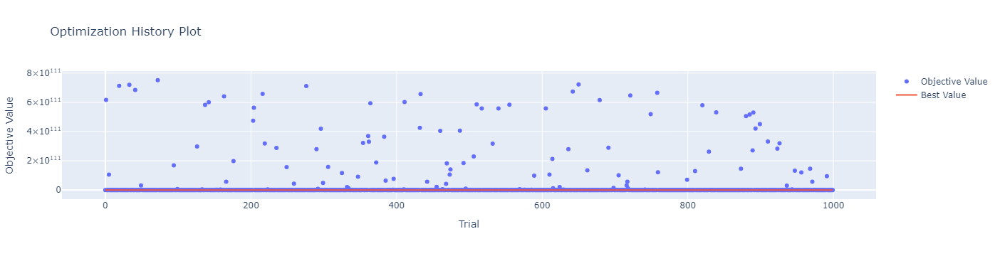

In [170]:
optuna.visualization.plot_optimization_history(study)

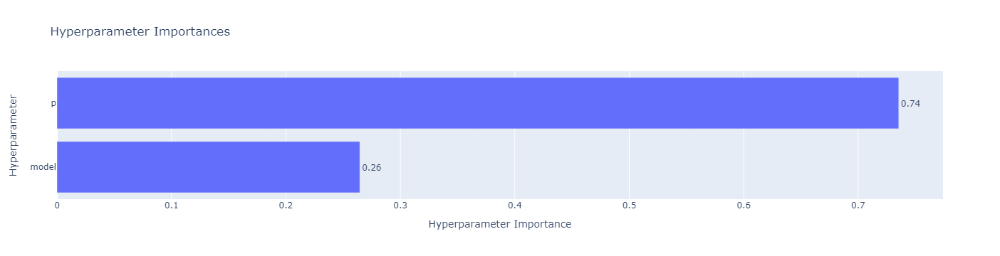

In [171]:
optuna.visualization.plot_param_importances(study)

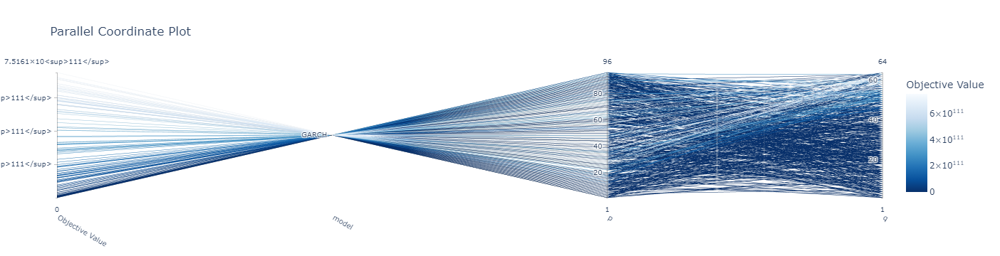

In [172]:
optuna.visualization.plot_parallel_coordinate(study)

In [173]:
optuna.visualization.plot_slice(study, params=["model", "p", "q"])

In [174]:
optuna.visualization.plot_edf(study)

### Оптимизация гиперпараметров на прошлых 1000 точек данных 

In [184]:
def objective(trial):
    model = trial.suggest_categorical("model", ["ARCH", "GARCH"])

    if model == "ARCH":
        p = trial.suggest_int("p", 1, 96)
        models = [ARCH(p=p)]
    elif model == "GARCH":
        p = trial.suggest_int("p", 1, 96)
        q = trial.suggest_int("q", 1, 64)
        models = [GARCH(p=p, q=q)]

    sf = StatsForecast(#df=train_univariate[-300:],
                       models=models,
                       freq='h',
                       n_jobs=-1)

    sf.fit(train_logreturn_univariate[-1000:])

    forecasts = sf.predict(h=300)
    
    rmse = losses.rmse(test_logreturn_univariate[:300]["y"].values, forecasts.iloc[:, -1].values)

    return rmse

In [185]:
study = optuna.create_study(direction="minimize", sampler=optuna.samplers.RandomSampler(seed=0))

[I 2024-09-15 09:21:49,188] A new study created in memory with name: no-name-7e30d51a-97e6-41af-b1f2-196e58ce7d73


In [186]:
study.optimize(objective, n_trials=1000)

clear_output()

In [187]:
print("Best hyperparameters:", study.best_params)
print("Best RMSE:", study.best_value)

Best hyperparameters: {'model': 'GARCH', 'p': 92, 'q': 24}
Best RMSE: 0.44583119978907043


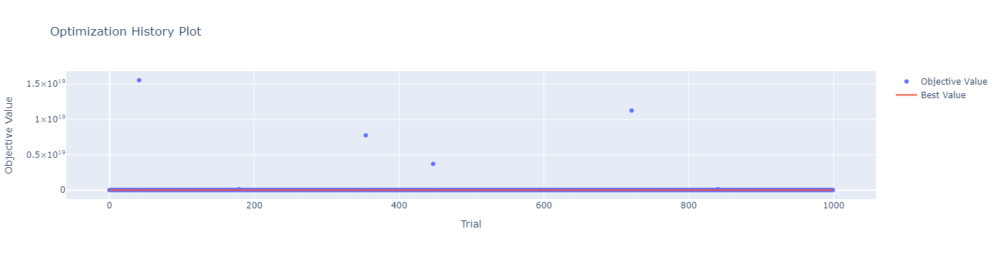

In [188]:
optuna.visualization.plot_optimization_history(study)

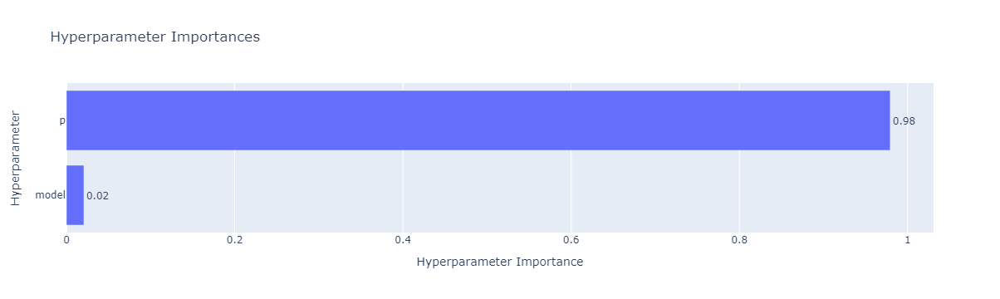

In [189]:
optuna.visualization.plot_param_importances(study)

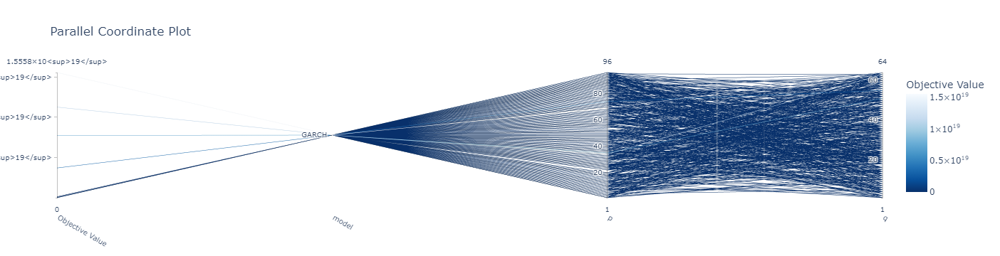

In [190]:
optuna.visualization.plot_parallel_coordinate(study)

In [191]:
optuna.visualization.plot_slice(study, params=["model", "p", "q"])

In [192]:
optuna.visualization.plot_edf(study)

### Оптимизация гиперпараметров на прошлых 300 точек данных 

In [175]:
def objective(trial):
    model = trial.suggest_categorical("model", ["ARCH", "GARCH"])

    if model == "ARCH":
        p = trial.suggest_int("p", 1, 96)
        models = [ARCH(p=p)]
    elif model == "GARCH":
        p = trial.suggest_int("p", 1, 96)
        q = trial.suggest_int("q", 1, 64)
        models = [GARCH(p=p, q=q)]

    sf = StatsForecast(#df=train_univariate[-300:],
                       models=models,
                       freq='h',
                       n_jobs=-1)

    sf.fit(train_logreturn_univariate[-300:])

    forecasts = sf.predict(h=300)
    
    rmse = losses.rmse(test_logreturn_univariate[:300]["y"].values, forecasts.iloc[:, -1].values)

    return rmse

In [176]:
study = optuna.create_study(direction="minimize", sampler=optuna.samplers.RandomSampler(seed=0))

[I 2024-09-15 09:12:16,264] A new study created in memory with name: no-name-a24e7ed5-db88-4bf5-9868-77d60312c178


In [177]:
study.optimize(objective, n_trials=1000)

clear_output()

In [178]:
print("Best hyperparameters:", study.best_params)
print("Best RMSE:", study.best_value)

Best hyperparameters: {'model': 'ARCH', 'p': 84}
Best RMSE: 0.40448681632651007


In [179]:
optuna.visualization.plot_optimization_history(study)

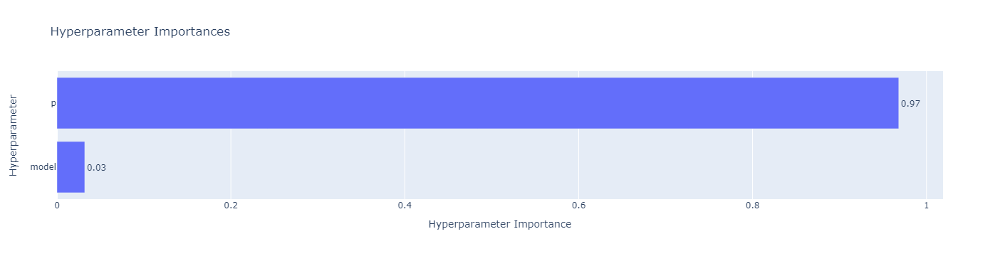

In [180]:
optuna.visualization.plot_param_importances(study)

In [181]:
optuna.visualization.plot_parallel_coordinate(study)

In [182]:
optuna.visualization.plot_slice(study, params=["model", "p", "q"])

In [183]:
optuna.visualization.plot_edf(study)

## Nixtla MLForecast для прогнозирования LogReturn

In [89]:
def calculate_aic(model, y_true, y_pred, k):
  """
  Calculates the Akaike Information Criterion (AIC).

  Args:
    model: The fitted model.
    y_true: True target values.
    y_pred: Predicted target values.
    k: Number of parameters in the model.

  Returns:
    The AIC value.
  """
  n = len(y_true)
  log_likelihood = -log_loss(y_true, y_pred)
  aic = 2 * k - 2 * log_likelihood
  return aic

def calculate_bic(model, y_true, y_pred, k, n):
  """
  Calculates the Bayesian Information Criterion (BIC).

  Args:
    model: The fitted model.
    y_true: True target values.
    y_pred: Predicted target values.
    k: Number of parameters in the model.
    n: Number of data points.

  Returns:
    The BIC value.
  """
  log_likelihood = -log_loss(y_true, y_pred)
  bic = np.log(n) * k - 2 * log_likelihood
  return bic

In [279]:
models = [
    LinearRegression(),
    Lasso(),
    KNeighborsRegressor(),
    SVR(),
    DecisionTreeRegressor(max_depth=10),
    RandomForestRegressor(n_estimators=500),
    GradientBoostingRegressor(n_estimators=500),
    lgb.LGBMRegressor(n_estimators=500, verbosity=-1),
    catboost.CatBoostRegressor(iterations=500, loss_function="RMSE", silent=True),
    #Naive()    
]

In [280]:
mlf = MLForecast(
    models=models,
    freq='h',  # our serie has a monthly frequency
    lags=list(range(1, 25, 1)),
    #target_transforms=[Differences([1])],
)

### Кросс валидация

In [281]:
crossvalidation_df = mlf.cross_validation(df=train_logreturn_univariate.iloc[-1000:],
                                         h=50,
                                         step_size=10,
                                         n_windows=10)

In [282]:
crossvalidation_df

,unique_id,ds,cutoff,y,LinearRegression,Lasso,KNeighborsRegressor,SVR,DecisionTreeRegressor,RandomForestRegressor,GradientBoostingRegressor,LGBMRegressor,CatBoostRegressor
0,1,2024-05-26 05:00:00,2024-05-26 04:00:00,0.235140,0.010542,0.008555,-0.036402,-0.039184,0.025627,-0.017300,-0.064497,0.093860,-0.044045
1,1,2024-05-26 06:00:00,2024-05-26 04:00:00,-0.054670,0.026702,0.008555,0.107725,0.029699,0.025627,0.053633,-0.010846,0.221472,0.060151
2,1,2024-05-26 07:00:00,2024-05-26 04:00:00,0.351063,-0.043375,0.008555,0.028185,0.040560,0.025627,0.004200,-0.040507,-0.110729,-0.004481
3,1,2024-05-26 08:00:00,2024-05-26 04:00:00,-0.264323,-0.037569,0.008555,0.079726,0.010351,0.025627,-0.001913,-0.103893,-0.123717,-0.069721
4,1,2024-05-26 09:00:00,2024-05-26 04:00:00,-0.109450,-0.024032,0.008555,0.002043,0.017550,0.025627,0.024189,-0.040105,0.158124,-0.010412
...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,1,2024-05-31 20:00:00,2024-05-29 22:00:00,0.042257,0.007862,0.005743,0.132758,0.024400,0.026999,0.002722,0.146239,-0.086476,0.063885
496,1,2024-05-31 21:00:00,2024-05-29 22:00:00,-0.205140,0.005101,0.005743,-0.025199,0.017845,0.026999,0.020280,0.179908,0.154736,0.091157
497,1,2024-05-31 22:00:00,2024-05-29 22:00:00,-0.090424,0.004996,0.005743,-0.060838,-0.002982,0.026999,-0.006200,-0.054853,0.033545,-0.067146
498,1,2024-05-31 23:00:00,2024-05-29 22:00:00,0.048437,0.006262,0.005743,0.058594,0.003163,0.026999,-0.002816,-0.093210,-0.108705,0.024974


In [283]:
crossvalidation_df.columns

Index(['unique_id', 'ds', 'cutoff', 'y', 'LinearRegression', 'Lasso',
       'KNeighborsRegressor', 'SVR', 'DecisionTreeRegressor',
       'RandomForestRegressor', 'GradientBoostingRegressor', 'LGBMRegressor',
       'CatBoostRegressor'],
      dtype='object')

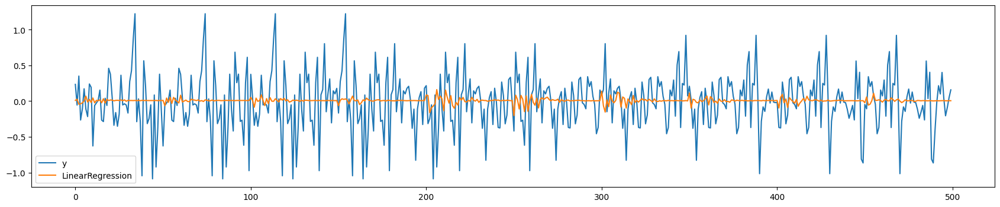

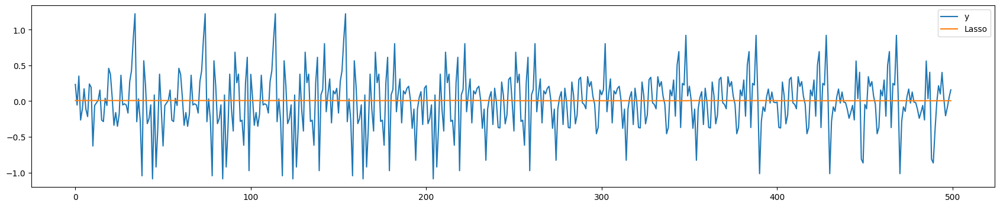

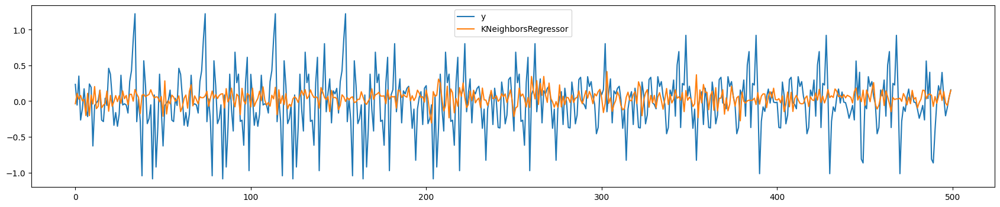

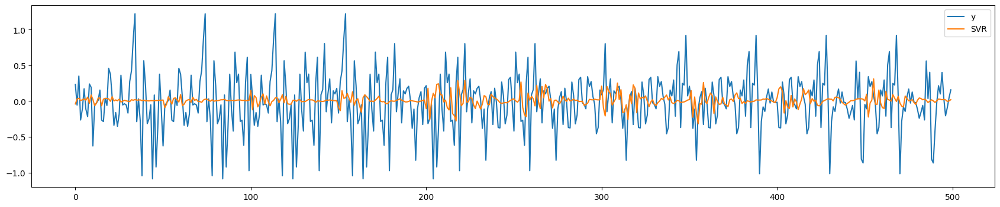

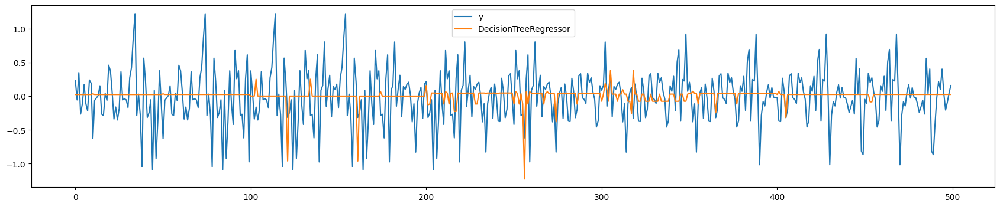

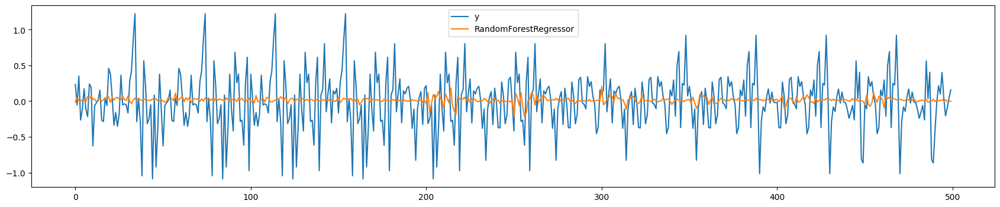

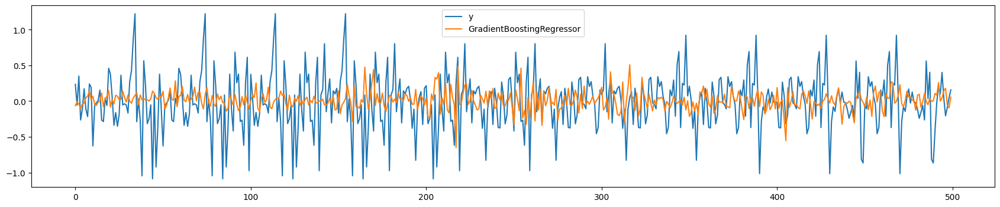

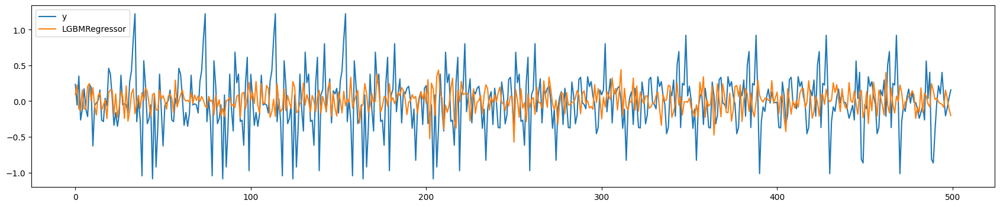

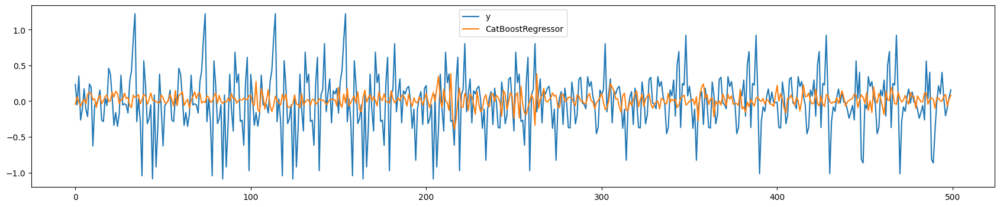

In [284]:
for i in crossvalidation_df.columns[4:]:
    crossvalidation_df.reset_index()[["y", i]].plot(figsize=(21, 4))
    plt.show()

### Оптимизация гиперпараметров на прошлых 5000 точек данных 

In [86]:
def objective(trial):
    model = trial.suggest_categorical(
        "model", 
        [
            "LinearRegression", 
            "Ridge",
            "KNeighborsRegressor",
            "SVR",
            "DecisionTreeRegressor",
#            "RandomForestRegressor",
            "GradientBoostingRegressor",
            "LGBMRegressor",
            "CatBoostRegressor"
        ]
    )
    
    if model == "LinearRegression":
        models = [LinearRegression()]
        print(f"models: {models}")
        
    elif model == "Ridge":
        alpha = trial.suggest_float("alpha_r", 0.001, 2.5)
        models = [Ridge(alpha=alpha, random_state=0)]
        print(f"models: {models} alpha: {alpha}")
        
    elif model == "KNeighborsRegressor":
        n_neighbors = trial.suggest_int("n_neighbors_knr", 2, 50)
        weights = trial.suggest_categorical("weights_knr", ['uniform', 'distance'])
        leaf_size = trial.suggest_int("leaf_size_knr", 20, 50)
        models = [KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, leaf_size=leaf_size)]
        print(f"models: {models} n_neighbors: {n_neighbors} weights: {weights} leaf_size: {leaf_size}")
        
    elif model == "SVR":
        kernel = trial.suggest_categorical("kernel_svr", ['linear', 'poly', 'rbf'])
        degree = trial.suggest_int("degree_svr", 1, 3)
        c = trial.suggest_float("c_svr", 0.001, 2.5) 
        models = [SVR(kernel=kernel, degree=degree, C=c)]
        print(f"models: {models} kernel: {kernel} degree: {degree} c: {c}")
        
    elif model == "DecisionTreeRegressor":
        criterion = trial.suggest_categorical("criterion_dtr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_dtr", 5, 50)
        models = [DecisionTreeRegressor(criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "RandomForestRegressor":
        n_estimators = trial.suggest_int("n_estimators_rfr", 100, 1000)
        criterion = trial.suggest_categorical("criterion_rfr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_rfr", 3, 50)
        models = [RandomForestRegressor(n_estimators=n_estimators, criterion=criterion, max_depth=max_depth, 
                                        random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "GradientBoostingRegressor":
        n_estimators = trial.suggest_int("n_estimators_gbr", 100, 250)
        loss = trial.suggest_categorical("loss_gbr", ['squared_error', 'absolute_error', 'huber'])
        learning_rate = trial.suggest_float("learning_rate_gbr", 0.001, 1.0) 
        criterion = trial.suggest_categorical("criterion_gbr", ['friedman_mse', 'squared_error'])
        max_depth = trial.suggest_int("max_depth_gbr", 3, 50)
        models = [GradientBoostingRegressor(n_estimators=n_estimators, loss=loss, learning_rate=learning_rate,
                                           criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} loss: {loss} learning_rate: {learning_rate} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "LGBMRegressor":
        n_estimators = trial.suggest_int("n_estimators_lgbm", 100, 1000)
        boosting_type = trial.suggest_categorical("boosting_type_lgbm", ['gbdt', 'dart'])
        num_leaves = trial.suggest_int("num_leaves_lgbm", 31, 100)
        max_depth = trial.suggest_int("max_depth_lgbm", 3, 50)
        learning_rate = trial.suggest_float("learning_rate_lgbm", 0.001, 1.0) 
        models = [lgb.LGBMRegressor(n_estimators=n_estimators, boosting_type=boosting_type, num_leaves=num_leaves,
                                    max_depth=max_depth, learning_rate=learning_rate, verbosity=-1, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} boosting_type: {boosting_type} num_leaves: {num_leaves} max_depth: {max_depth} learning_rate: {learning_rate}")
        
    elif model == "CatBoostRegressor":
        iterations = trial.suggest_int("iterations_cbr", 100, 250)
        learning_rate = trial.suggest_float("learning_rate_cbr", 0.01, 1.0) 
        max_depth = trial.suggest_int("max_depth_cbr", 3, 16)
        models = [catboost.CatBoostRegressor(iterations=iterations, learning_rate=learning_rate, max_depth=max_depth,
                                             loss_function="RMSE", silent=True, random_seed=0)]
        print(f"models: {models} iterations: {iterations} learning_rate: {learning_rate} max_depth: {max_depth}")

    lags = trial.suggest_int("lags", 1, 100)
    
    mlf = MLForecast(
        models=models,
        freq='h',
        lags=list(range(1, lags+1, 1)),
        #target_transforms=[Differences([1])],
    )

    mlf.fit(train_logreturn_univariate[-5000:])

    forecasts = mlf.predict(h=300)
    
    rmse = losses.rmse(test_logreturn_univariate[:300]["y"].values, forecasts.iloc[:, -1].values)

    return rmse

In [87]:
study = optuna.create_study(direction="minimize", sampler=optuna.samplers.RandomSampler(seed=1))

[I 2024-09-15 15:48:29,363] A new study created in memory with name: no-name-f3d37d04-b81d-40ab-8785-e7fb8e692e84


In [88]:
study.optimize(objective, n_trials=100)

clear_output()

In [90]:
print("Best hyperparameters:", study.best_params)
print("Best RMSE:", study.best_value)

Best hyperparameters: {'model': 'SVR', 'kernel_svr': 'rbf', 'degree_svr': 5, 'c_svr': 1.5546176048025953, 'lags': 12}
Best RMSE: 0.37892094418346606


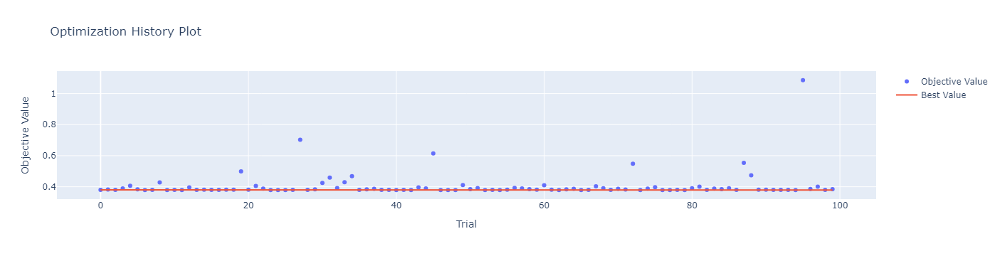

In [91]:
optuna.visualization.plot_optimization_history(study)

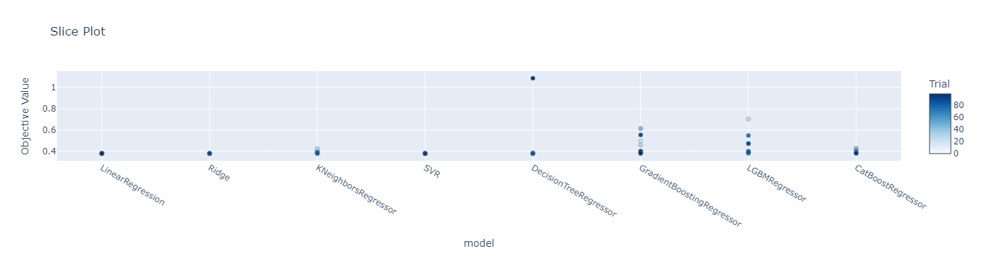

In [92]:
optuna.visualization.plot_slice(study, params=["model"])

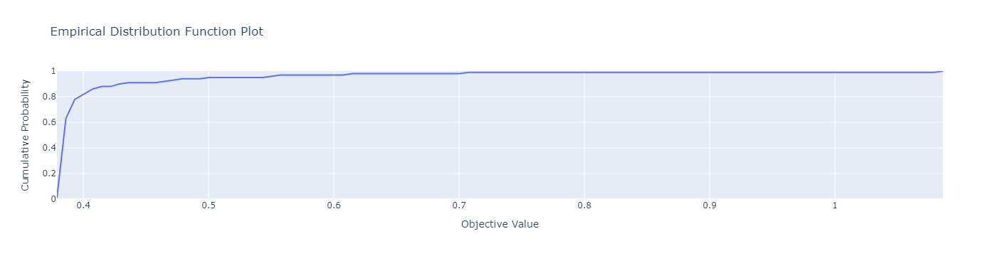

In [93]:
optuna.visualization.plot_edf(study)

### Оптимизация гиперпараметров на прошлых 1000 точек данных 

In [70]:
def objective(trial):
    model = trial.suggest_categorical(
        "model", 
        [
            "LinearRegression", 
            "Ridge",
            "KNeighborsRegressor",
            "SVR",
            "DecisionTreeRegressor",
            "RandomForestRegressor",
            "GradientBoostingRegressor",
            "LGBMRegressor",
            "CatBoostRegressor"
        ]
    )
    
    if model == "LinearRegression":
        models = [LinearRegression()]
        print(f"models: {models}")
        
    elif model == "Ridge":
        alpha = trial.suggest_float("alpha_r", 0.001, 2.5)
        models = [Ridge(alpha=alpha, random_state=0)]
        print(f"models: {models} alpha: {alpha}")
        
    elif model == "KNeighborsRegressor":
        n_neighbors = trial.suggest_int("n_neighbors_knr", 2, 50)
        weights = trial.suggest_categorical("weights_knr", ['uniform', 'distance'])
        leaf_size = trial.suggest_int("leaf_size_knr", 20, 50)
        models = [KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, leaf_size=leaf_size)]
        print(f"models: {models} n_neighbors: {n_neighbors} weights: {weights} leaf_size: {leaf_size}")
        
    elif model == "SVR":
        kernel = trial.suggest_categorical("kernel_svr", ['linear', 'poly', 'rbf'])
        degree = trial.suggest_int("degree_svr", 1, 3)
        c = trial.suggest_float("c_svr", 0.001, 2.5) 
        models = [SVR(kernel=kernel, degree=degree, C=c)]
        print(f"models: {models} kernel: {kernel} degree: {degree} c: {c}")
        
    elif model == "DecisionTreeRegressor":
        criterion = trial.suggest_categorical("criterion_dtr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_dtr", 5, 50)
        models = [DecisionTreeRegressor(criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "RandomForestRegressor":
        n_estimators = trial.suggest_int("n_estimators_rfr", 100, 1000)
        criterion = trial.suggest_categorical("criterion_rfr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_rfr", 3, 50)
        models = [RandomForestRegressor(n_estimators=n_estimators, criterion=criterion, max_depth=max_depth, 
                                        random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "GradientBoostingRegressor":
        n_estimators = trial.suggest_int("n_estimators_gbr", 100, 250)
        loss = trial.suggest_categorical("loss_gbr", ['squared_error', 'absolute_error', 'huber'])
        learning_rate = trial.suggest_float("learning_rate_gbr", 0.001, 1.0) 
        criterion = trial.suggest_categorical("criterion_gbr", ['friedman_mse', 'squared_error'])
        max_depth = trial.suggest_int("max_depth_gbr", 3, 50)
        models = [GradientBoostingRegressor(n_estimators=n_estimators, loss=loss, learning_rate=learning_rate,
                                           criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} loss: {loss} learning_rate: {learning_rate} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "LGBMRegressor":
        n_estimators = trial.suggest_int("n_estimators_lgbm", 100, 1000)
        boosting_type = trial.suggest_categorical("boosting_type_lgbm", ['gbdt', 'dart'])
        num_leaves = trial.suggest_int("num_leaves_lgbm", 31, 100)
        max_depth = trial.suggest_int("max_depth_lgbm", 3, 50)
        learning_rate = trial.suggest_float("learning_rate_lgbm", 0.001, 1.0) 
        models = [lgb.LGBMRegressor(n_estimators=n_estimators, boosting_type=boosting_type, num_leaves=num_leaves,
                                    max_depth=max_depth, learning_rate=learning_rate, verbosity=-1, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} boosting_type: {boosting_type} num_leaves: {num_leaves} max_depth: {max_depth} learning_rate: {learning_rate}")
        
    elif model == "CatBoostRegressor":
        iterations = trial.suggest_int("iterations_cbr", 100, 250)
        learning_rate = trial.suggest_float("learning_rate_cbr", 0.01, 1.0) 
        max_depth = trial.suggest_int("max_depth_cbr", 3, 16)
        models = [catboost.CatBoostRegressor(iterations=iterations, learning_rate=learning_rate, max_depth=max_depth,
                                             loss_function="RMSE", silent=True, random_seed=0)]
        print(f"models: {models} iterations: {iterations} learning_rate: {learning_rate} max_depth: {max_depth}")

    lags = trial.suggest_int("lags", 1, 100)
    
    mlf = MLForecast(
        models=models,
        freq='h',
        lags=list(range(1, lags+1, 1)),
        #target_transforms=[Differences([1])],
    )

    mlf.fit(train_logreturn_univariate[-1000:])

    forecasts = mlf.predict(h=300)
    
    rmse = losses.rmse(test_logreturn_univariate[:300]["y"].values, forecasts.iloc[:, -1].values)

    return rmse

In [71]:
study = optuna.create_study(direction="minimize", sampler=optuna.samplers.RandomSampler(seed=1))

[I 2024-09-15 18:39:37,376] A new study created in memory with name: no-name-8ad652e2-8109-4cda-a7ae-e151c0dd74d4


In [72]:
study.optimize(objective, n_trials=100)

clear_output()

In [73]:
print("Best hyperparameters:", study.best_params)
print("Best RMSE:", study.best_value)

Best hyperparameters: {'model': 'RandomForestRegressor', 'n_estimators_rfr': 895, 'criterion_rfr': 'friedman_mse', 'max_depth_rfr': 15, 'lags': 90}
Best RMSE: 0.3784899337943229


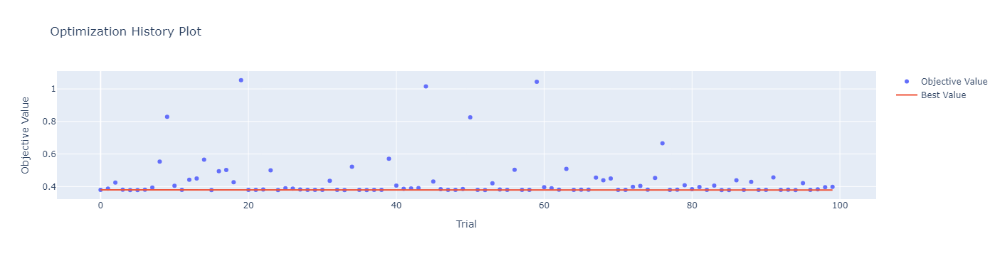

In [74]:
optuna.visualization.plot_optimization_history(study)

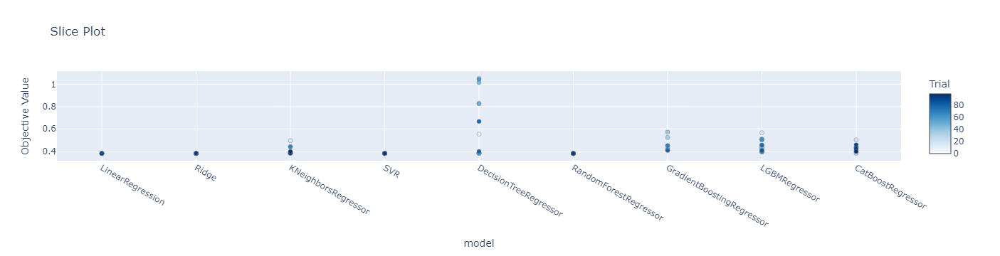

In [75]:
optuna.visualization.plot_slice(study, params=["model"])

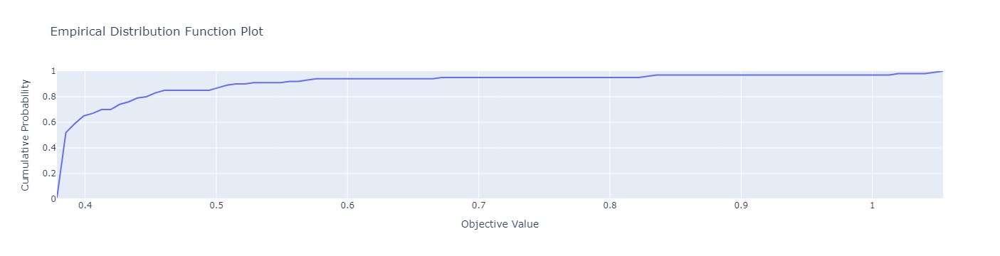

In [76]:
optuna.visualization.plot_edf(study)

### Оптимизация гиперпараметров на прошлых 300 точек данных 

In [77]:
def objective(trial):
    model = trial.suggest_categorical(
        "model", 
        [
            "LinearRegression", 
            "Ridge",
            "KNeighborsRegressor",
            "SVR",
            "DecisionTreeRegressor",
            "RandomForestRegressor",
            "GradientBoostingRegressor",
            "LGBMRegressor",
            "CatBoostRegressor"
        ]
    )
    
    if model == "LinearRegression":
        models = [LinearRegression()]
        print(f"models: {models}")
        
    elif model == "Ridge":
        alpha = trial.suggest_float("alpha_r", 0.001, 2.5)
        models = [Ridge(alpha=alpha, random_state=0)]
        print(f"models: {models} alpha: {alpha}")
        
    elif model == "KNeighborsRegressor":
        n_neighbors = trial.suggest_int("n_neighbors_knr", 2, 50)
        weights = trial.suggest_categorical("weights_knr", ['uniform', 'distance'])
        leaf_size = trial.suggest_int("leaf_size_knr", 20, 50)
        models = [KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, leaf_size=leaf_size)]
        print(f"models: {models} n_neighbors: {n_neighbors} weights: {weights} leaf_size: {leaf_size}")
        
    elif model == "SVR":
        kernel = trial.suggest_categorical("kernel_svr", ['linear', 'poly', 'rbf'])
        degree = trial.suggest_int("degree_svr", 1, 3)
        c = trial.suggest_float("c_svr", 0.001, 2.5) 
        models = [SVR(kernel=kernel, degree=degree, C=c)]
        print(f"models: {models} kernel: {kernel} degree: {degree} c: {c}")
        
    elif model == "DecisionTreeRegressor":
        criterion = trial.suggest_categorical("criterion_dtr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_dtr", 5, 50)
        models = [DecisionTreeRegressor(criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "RandomForestRegressor":
        n_estimators = trial.suggest_int("n_estimators_rfr", 100, 1000)
        criterion = trial.suggest_categorical("criterion_rfr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_rfr", 3, 50)
        models = [RandomForestRegressor(n_estimators=n_estimators, criterion=criterion, max_depth=max_depth, 
                                        random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "GradientBoostingRegressor":
        n_estimators = trial.suggest_int("n_estimators_gbr", 100, 250)
        loss = trial.suggest_categorical("loss_gbr", ['squared_error', 'absolute_error', 'huber'])
        learning_rate = trial.suggest_float("learning_rate_gbr", 0.001, 1.0) 
        criterion = trial.suggest_categorical("criterion_gbr", ['friedman_mse', 'squared_error'])
        max_depth = trial.suggest_int("max_depth_gbr", 3, 50)
        models = [GradientBoostingRegressor(n_estimators=n_estimators, loss=loss, learning_rate=learning_rate,
                                           criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} loss: {loss} learning_rate: {learning_rate} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "LGBMRegressor":
        n_estimators = trial.suggest_int("n_estimators_lgbm", 100, 1000)
        boosting_type = trial.suggest_categorical("boosting_type_lgbm", ['gbdt', 'dart'])
        num_leaves = trial.suggest_int("num_leaves_lgbm", 31, 100)
        max_depth = trial.suggest_int("max_depth_lgbm", 3, 50)
        learning_rate = trial.suggest_float("learning_rate_lgbm", 0.001, 1.0) 
        models = [lgb.LGBMRegressor(n_estimators=n_estimators, boosting_type=boosting_type, num_leaves=num_leaves,
                                    max_depth=max_depth, learning_rate=learning_rate, verbosity=-1, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} boosting_type: {boosting_type} num_leaves: {num_leaves} max_depth: {max_depth} learning_rate: {learning_rate}")
        
    elif model == "CatBoostRegressor":
        iterations = trial.suggest_int("iterations_cbr", 100, 250)
        learning_rate = trial.suggest_float("learning_rate_cbr", 0.01, 1.0) 
        max_depth = trial.suggest_int("max_depth_cbr", 3, 16)
        models = [catboost.CatBoostRegressor(iterations=iterations, learning_rate=learning_rate, max_depth=max_depth,
                                             loss_function="RMSE", silent=True, random_seed=0)]
        print(f"models: {models} iterations: {iterations} learning_rate: {learning_rate} max_depth: {max_depth}")

    lags = trial.suggest_int("lags", 1, 100)
    
    mlf = MLForecast(
        models=models,
        freq='h',
        lags=list(range(1, lags+1, 1)),
        #target_transforms=[Differences([1])],
    )

    mlf.fit(train_logreturn_univariate[-300:])

    forecasts = mlf.predict(h=300)
    
    rmse = losses.rmse(test_logreturn_univariate[:300]["y"].values, forecasts.iloc[:, -1].values)

    return rmse

In [78]:
study = optuna.create_study(direction="minimize", sampler=optuna.samplers.RandomSampler(seed=1))

[I 2024-09-15 19:37:34,920] A new study created in memory with name: no-name-0fbf7d8e-115e-41d4-b4d8-8241a333169f


In [79]:
study.optimize(objective, n_trials=100)

clear_output()

In [80]:
print("Best hyperparameters:", study.best_params)
print("Best RMSE:", study.best_value)

Best hyperparameters: {'model': 'RandomForestRegressor', 'n_estimators_rfr': 231, 'criterion_rfr': 'absolute_error', 'max_depth_rfr': 46, 'lags': 99}
Best RMSE: 0.376414663852517


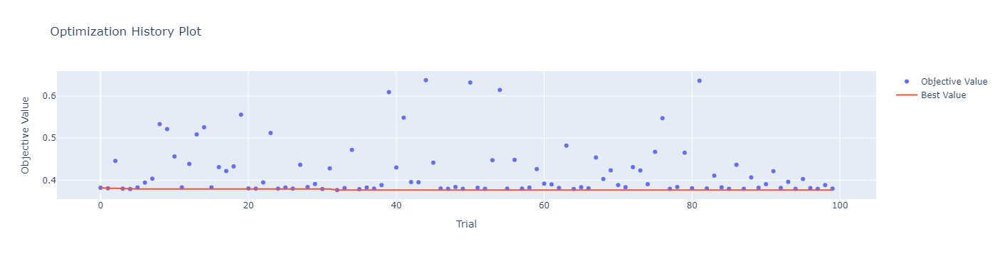

In [81]:
optuna.visualization.plot_optimization_history(study)

In [82]:
optuna.visualization.plot_slice(study, params=["model"])

In [83]:
optuna.visualization.plot_edf(study)

### Оптимизация гиперпараметров на прошлых 5000 точек данных (KNeighborsRegressor, SVR, LGBMRegressor)

In [99]:
def objective(trial):
    model = trial.suggest_categorical(
        "model", 
        [
#            "LinearRegression", 
#            "Ridge",
            "KNeighborsRegressor",
            "SVR",
#            "DecisionTreeRegressor",
#            "RandomForestRegressor",
#            "GradientBoostingRegressor",
            "LGBMRegressor",
#            "CatBoostRegressor"
        ]
    )
    
    if model == "LinearRegression":
        models = [LinearRegression()]
        print(f"models: {models}")
        
    elif model == "Ridge":
        alpha = trial.suggest_float("alpha_r", 0.001, 2.5)
        models = [Ridge(alpha=alpha, random_state=0)]
        print(f"models: {models} alpha: {alpha}")
        
    elif model == "KNeighborsRegressor":
        n_neighbors = trial.suggest_int("n_neighbors_knr", 2, 50)
        weights = trial.suggest_categorical("weights_knr", ['uniform', 'distance'])
        leaf_size = trial.suggest_int("leaf_size_knr", 20, 50)
        models = [KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, leaf_size=leaf_size)]
        print(f"models: {models} n_neighbors: {n_neighbors} weights: {weights} leaf_size: {leaf_size}")
        
    elif model == "SVR":
        kernel = trial.suggest_categorical("kernel_svr", ['linear', 'poly', 'rbf'])
        degree = trial.suggest_int("degree_svr", 1, 3)
        c = trial.suggest_float("c_svr", 0.001, 2.5) 
        models = [SVR(kernel=kernel, degree=degree, C=c)]
        print(f"models: {models} kernel: {kernel} degree: {degree} c: {c}")
        
    elif model == "DecisionTreeRegressor":
        criterion = trial.suggest_categorical("criterion_dtr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_dtr", 5, 50)
        models = [DecisionTreeRegressor(criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "RandomForestRegressor":
        n_estimators = trial.suggest_int("n_estimators_rfr", 100, 1000)
        criterion = trial.suggest_categorical("criterion_rfr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_rfr", 3, 50)
        models = [RandomForestRegressor(n_estimators=n_estimators, criterion=criterion, max_depth=max_depth, 
                                        random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "GradientBoostingRegressor":
        n_estimators = trial.suggest_int("n_estimators_gbr", 100, 250)
        loss = trial.suggest_categorical("loss_gbr", ['squared_error', 'absolute_error', 'huber'])
        learning_rate = trial.suggest_float("learning_rate_gbr", 0.001, 1.0) 
        criterion = trial.suggest_categorical("criterion_gbr", ['friedman_mse', 'squared_error'])
        max_depth = trial.suggest_int("max_depth_gbr", 3, 50)
        models = [GradientBoostingRegressor(n_estimators=n_estimators, loss=loss, learning_rate=learning_rate,
                                           criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} loss: {loss} learning_rate: {learning_rate} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "LGBMRegressor":
        n_estimators = trial.suggest_int("n_estimators_lgbm", 100, 1000)
        boosting_type = trial.suggest_categorical("boosting_type_lgbm", ['gbdt', 'dart'])
        num_leaves = trial.suggest_int("num_leaves_lgbm", 31, 100)
        max_depth = trial.suggest_int("max_depth_lgbm", 3, 50)
        learning_rate = trial.suggest_float("learning_rate_lgbm", 0.001, 1.0) 
        models = [lgb.LGBMRegressor(n_estimators=n_estimators, boosting_type=boosting_type, num_leaves=num_leaves,
                                    max_depth=max_depth, learning_rate=learning_rate, verbosity=-1, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} boosting_type: {boosting_type} num_leaves: {num_leaves} max_depth: {max_depth} learning_rate: {learning_rate}")
        
    elif model == "CatBoostRegressor":
        iterations = trial.suggest_int("iterations_cbr", 100, 250)
        learning_rate = trial.suggest_float("learning_rate_cbr", 0.01, 1.0) 
        max_depth = trial.suggest_int("max_depth_cbr", 3, 16)
        models = [catboost.CatBoostRegressor(iterations=iterations, learning_rate=learning_rate, max_depth=max_depth,
                                             loss_function="RMSE", silent=True, random_seed=0)]
        print(f"models: {models} iterations: {iterations} learning_rate: {learning_rate} max_depth: {max_depth}")

    lags = trial.suggest_int("lags", 1, 100)
    
    mlf = MLForecast(
        models=models,
        freq='h',
        lags=list(range(1, lags+1, 1)),
        #target_transforms=[Differences([1])],
    )

    mlf.fit(train_logreturn_univariate[-5000:])

    forecasts = mlf.predict(h=300)
    
    rmse = losses.rmse(test_logreturn_univariate[:300]["y"].values, forecasts.iloc[:, -1].values)

    return rmse

In [100]:
study = optuna.create_study(direction="minimize", sampler=optuna.samplers.RandomSampler(seed=1))

[I 2024-09-15 20:32:02,899] A new study created in memory with name: no-name-cc30dc8f-2a4c-4cf0-aaa3-3c56455d3f8c


In [101]:
study.optimize(objective, n_trials=100)

clear_output()

Топ 2
{'model': 'LGBMRegressor', 'n_estimators_lgbm': 382, 'boosting_type_lgbm': 'dart', 'num_leaves_lgbm': 93, 'max_depth_lgbm': 7, 'learning_rate_lgbm': 0.04001572844964948, 'lags': 17}

In [102]:
print("Best hyperparameters:", study.best_params)
print("Best RMSE:", study.best_value)

Best hyperparameters: {'model': 'SVR', 'kernel_svr': 'poly', 'degree_svr': 3, 'c_svr': 0.9702637495163653, 'lags': 87}
Best RMSE: 0.37890510362073204


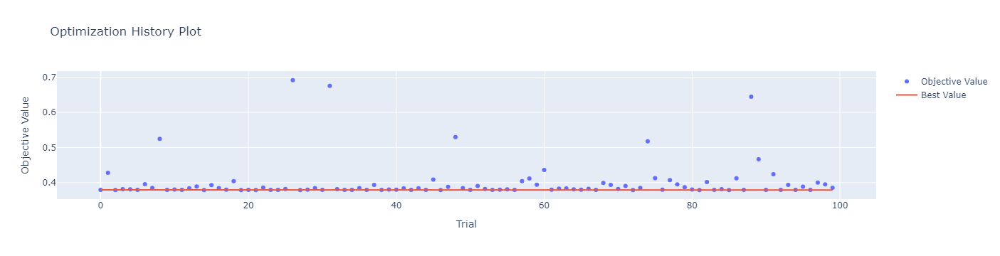

In [103]:
optuna.visualization.plot_optimization_history(study)

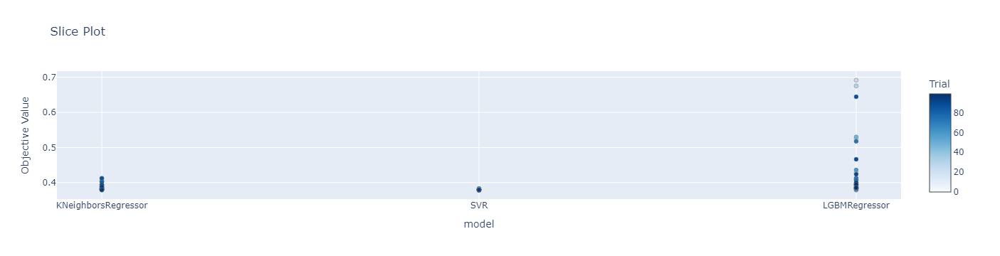

In [104]:
optuna.visualization.plot_slice(study, params=["model"])

In [105]:
optuna.visualization.plot_edf(study)

### Оптимизация гиперпараметров на прошлых 1000 точек данных (KNeighborsRegressor, SVR, LGBMRegressor)

In [106]:
def objective(trial):
    model = trial.suggest_categorical(
        "model", 
        [
#            "LinearRegression", 
#            "Ridge",
            "KNeighborsRegressor",
            "SVR",
#            "DecisionTreeRegressor",
#            "RandomForestRegressor",
#            "GradientBoostingRegressor",
            "LGBMRegressor",
#            "CatBoostRegressor"
        ]
    )
    
    if model == "LinearRegression":
        models = [LinearRegression()]
        print(f"models: {models}")
        
    elif model == "Ridge":
        alpha = trial.suggest_float("alpha_r", 0.001, 2.5)
        models = [Ridge(alpha=alpha, random_state=0)]
        print(f"models: {models} alpha: {alpha}")
        
    elif model == "KNeighborsRegressor":
        n_neighbors = trial.suggest_int("n_neighbors_knr", 2, 50)
        weights = trial.suggest_categorical("weights_knr", ['uniform', 'distance'])
        leaf_size = trial.suggest_int("leaf_size_knr", 20, 50)
        models = [KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, leaf_size=leaf_size)]
        print(f"models: {models} n_neighbors: {n_neighbors} weights: {weights} leaf_size: {leaf_size}")
        
    elif model == "SVR":
        kernel = trial.suggest_categorical("kernel_svr", ['linear', 'poly', 'rbf'])
        degree = trial.suggest_int("degree_svr", 1, 3)
        c = trial.suggest_float("c_svr", 0.001, 2.5) 
        models = [SVR(kernel=kernel, degree=degree, C=c)]
        print(f"models: {models} kernel: {kernel} degree: {degree} c: {c}")
        
    elif model == "DecisionTreeRegressor":
        criterion = trial.suggest_categorical("criterion_dtr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_dtr", 5, 50)
        models = [DecisionTreeRegressor(criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "RandomForestRegressor":
        n_estimators = trial.suggest_int("n_estimators_rfr", 100, 1000)
        criterion = trial.suggest_categorical("criterion_rfr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_rfr", 3, 50)
        models = [RandomForestRegressor(n_estimators=n_estimators, criterion=criterion, max_depth=max_depth, 
                                        random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "GradientBoostingRegressor":
        n_estimators = trial.suggest_int("n_estimators_gbr", 100, 250)
        loss = trial.suggest_categorical("loss_gbr", ['squared_error', 'absolute_error', 'huber'])
        learning_rate = trial.suggest_float("learning_rate_gbr", 0.001, 1.0) 
        criterion = trial.suggest_categorical("criterion_gbr", ['friedman_mse', 'squared_error'])
        max_depth = trial.suggest_int("max_depth_gbr", 3, 50)
        models = [GradientBoostingRegressor(n_estimators=n_estimators, loss=loss, learning_rate=learning_rate,
                                           criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} loss: {loss} learning_rate: {learning_rate} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "LGBMRegressor":
        n_estimators = trial.suggest_int("n_estimators_lgbm", 100, 1000)
        boosting_type = trial.suggest_categorical("boosting_type_lgbm", ['gbdt', 'dart'])
        num_leaves = trial.suggest_int("num_leaves_lgbm", 31, 100)
        max_depth = trial.suggest_int("max_depth_lgbm", 3, 50)
        learning_rate = trial.suggest_float("learning_rate_lgbm", 0.001, 1.0) 
        models = [lgb.LGBMRegressor(n_estimators=n_estimators, boosting_type=boosting_type, num_leaves=num_leaves,
                                    max_depth=max_depth, learning_rate=learning_rate, verbosity=-1, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} boosting_type: {boosting_type} num_leaves: {num_leaves} max_depth: {max_depth} learning_rate: {learning_rate}")
        
    elif model == "CatBoostRegressor":
        iterations = trial.suggest_int("iterations_cbr", 100, 250)
        learning_rate = trial.suggest_float("learning_rate_cbr", 0.01, 1.0) 
        max_depth = trial.suggest_int("max_depth_cbr", 3, 16)
        models = [catboost.CatBoostRegressor(iterations=iterations, learning_rate=learning_rate, max_depth=max_depth,
                                             loss_function="RMSE", silent=True, random_seed=0)]
        print(f"models: {models} iterations: {iterations} learning_rate: {learning_rate} max_depth: {max_depth}")

    lags = trial.suggest_int("lags", 1, 100)
    
    mlf = MLForecast(
        models=models,
        freq='h',
        lags=list(range(1, lags+1, 1)),
        #target_transforms=[Differences([1])],
    )

    mlf.fit(train_logreturn_univariate[-1000:])

    forecasts = mlf.predict(h=300)
    
    rmse = losses.rmse(test_logreturn_univariate[:300]["y"].values, forecasts.iloc[:, -1].values)

    return rmse

In [107]:
study = optuna.create_study(direction="minimize", sampler=optuna.samplers.RandomSampler(seed=1))

[I 2024-09-15 20:42:06,131] A new study created in memory with name: no-name-bf1da8a5-0be4-49c7-9cf0-4fb941f7748a


In [108]:
study.optimize(objective, n_trials=100)

clear_output()

In [109]:
print("Best hyperparameters:", study.best_params)
print("Best RMSE:", study.best_value)

Best hyperparameters: {'model': 'KNeighborsRegressor', 'n_neighbors_knr': 27, 'weights_knr': 'uniform', 'leaf_size_knr': 34, 'lags': 35}
Best RMSE: 0.37790294454622764


In [110]:
optuna.visualization.plot_optimization_history(study)

In [111]:
optuna.visualization.plot_slice(study, params=["model"])

In [112]:
optuna.visualization.plot_edf(study)

### Оптимизация гиперпараметров на прошлых 300 точек данных (KNeighborsRegressor, SVR, LGBMRegressor)

In [113]:
def objective(trial):
    model = trial.suggest_categorical(
        "model", 
        [
#            "LinearRegression", 
#            "Ridge",
            "KNeighborsRegressor",
            "SVR",
#            "DecisionTreeRegressor",
#            "RandomForestRegressor",
#            "GradientBoostingRegressor",
            "LGBMRegressor",
#            "CatBoostRegressor"
        ]
    )
    
    if model == "LinearRegression":
        models = [LinearRegression()]
        print(f"models: {models}")
        
    elif model == "Ridge":
        alpha = trial.suggest_float("alpha_r", 0.001, 2.5)
        models = [Ridge(alpha=alpha, random_state=0)]
        print(f"models: {models} alpha: {alpha}")
        
    elif model == "KNeighborsRegressor":
        n_neighbors = trial.suggest_int("n_neighbors_knr", 2, 50)
        weights = trial.suggest_categorical("weights_knr", ['uniform', 'distance'])
        leaf_size = trial.suggest_int("leaf_size_knr", 20, 50)
        models = [KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, leaf_size=leaf_size)]
        print(f"models: {models} n_neighbors: {n_neighbors} weights: {weights} leaf_size: {leaf_size}")
        
    elif model == "SVR":
        kernel = trial.suggest_categorical("kernel_svr", ['linear', 'poly', 'rbf'])
        degree = trial.suggest_int("degree_svr", 1, 3)
        c = trial.suggest_float("c_svr", 0.001, 2.5) 
        models = [SVR(kernel=kernel, degree=degree, C=c)]
        print(f"models: {models} kernel: {kernel} degree: {degree} c: {c}")
        
    elif model == "DecisionTreeRegressor":
        criterion = trial.suggest_categorical("criterion_dtr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_dtr", 5, 50)
        models = [DecisionTreeRegressor(criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "RandomForestRegressor":
        n_estimators = trial.suggest_int("n_estimators_rfr", 100, 1000)
        criterion = trial.suggest_categorical("criterion_rfr", ['squared_error', 'friedman_mse', 'absolute_error'])
        max_depth = trial.suggest_int("max_depth_rfr", 3, 50)
        models = [RandomForestRegressor(n_estimators=n_estimators, criterion=criterion, max_depth=max_depth, 
                                        random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "GradientBoostingRegressor":
        n_estimators = trial.suggest_int("n_estimators_gbr", 100, 250)
        loss = trial.suggest_categorical("loss_gbr", ['squared_error', 'absolute_error', 'huber'])
        learning_rate = trial.suggest_float("learning_rate_gbr", 0.001, 1.0) 
        criterion = trial.suggest_categorical("criterion_gbr", ['friedman_mse', 'squared_error'])
        max_depth = trial.suggest_int("max_depth_gbr", 3, 50)
        models = [GradientBoostingRegressor(n_estimators=n_estimators, loss=loss, learning_rate=learning_rate,
                                           criterion=criterion, max_depth=max_depth, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} loss: {loss} learning_rate: {learning_rate} criterion: {criterion} max_depth: {max_depth}")
        
    elif model == "LGBMRegressor":
        n_estimators = trial.suggest_int("n_estimators_lgbm", 100, 1000)
        boosting_type = trial.suggest_categorical("boosting_type_lgbm", ['gbdt', 'dart'])
        num_leaves = trial.suggest_int("num_leaves_lgbm", 31, 100)
        max_depth = trial.suggest_int("max_depth_lgbm", 3, 50)
        learning_rate = trial.suggest_float("learning_rate_lgbm", 0.001, 1.0) 
        models = [lgb.LGBMRegressor(n_estimators=n_estimators, boosting_type=boosting_type, num_leaves=num_leaves,
                                    max_depth=max_depth, learning_rate=learning_rate, verbosity=-1, random_state=0)]
        print(f"models: {models} n_estimators: {n_estimators} boosting_type: {boosting_type} num_leaves: {num_leaves} max_depth: {max_depth} learning_rate: {learning_rate}")
        
    elif model == "CatBoostRegressor":
        iterations = trial.suggest_int("iterations_cbr", 100, 250)
        learning_rate = trial.suggest_float("learning_rate_cbr", 0.01, 1.0) 
        max_depth = trial.suggest_int("max_depth_cbr", 3, 16)
        models = [catboost.CatBoostRegressor(iterations=iterations, learning_rate=learning_rate, max_depth=max_depth,
                                             loss_function="RMSE", silent=True, random_seed=0)]
        print(f"models: {models} iterations: {iterations} learning_rate: {learning_rate} max_depth: {max_depth}")

    lags = trial.suggest_int("lags", 1, 100)
    
    mlf = MLForecast(
        models=models,
        freq='h',
        lags=list(range(1, lags+1, 1)),
        #target_transforms=[Differences([1])],
    )

    mlf.fit(train_logreturn_univariate[-300:])

    forecasts = mlf.predict(h=300)
    
    rmse = losses.rmse(test_logreturn_univariate[:300]["y"].values, forecasts.iloc[:, -1].values)

    return rmse

In [114]:
study = optuna.create_study(direction="minimize", sampler=optuna.samplers.RandomSampler(seed=1))

[I 2024-09-15 20:49:07,647] A new study created in memory with name: no-name-1d58e00c-4b91-4b85-ba95-856032656bbc


In [115]:
study.optimize(objective, n_trials=100)

clear_output()

In [116]:
print("Best hyperparameters:", study.best_params)
print("Best RMSE:", study.best_value)

Best hyperparameters: {'model': 'KNeighborsRegressor', 'n_neighbors_knr': 43, 'weights_knr': 'uniform', 'leaf_size_knr': 36, 'lags': 80}
Best RMSE: 0.3779065178056397


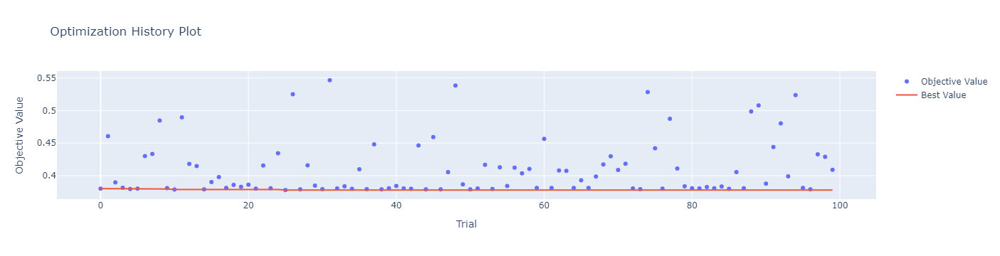

In [117]:
optuna.visualization.plot_optimization_history(study)

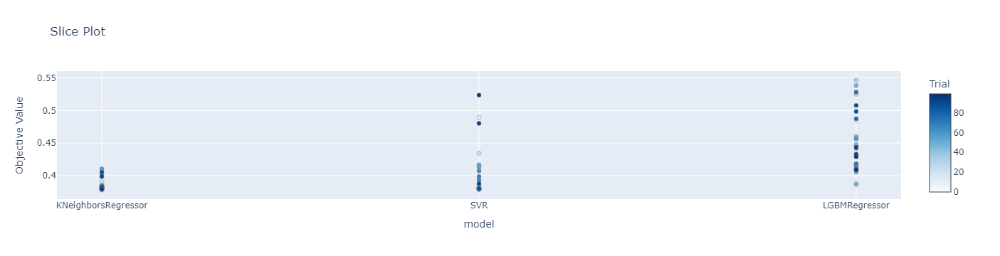

In [118]:
optuna.visualization.plot_slice(study, params=["model"])

In [119]:
optuna.visualization.plot_edf(study)

## Отбор лучших моделей

In [123]:
lgb.LGBMRegressor

lightgbm.sklearn.LGBMRegressor

In [125]:
sf_1 = StatsForecast(
    models=[ARCH(96)],
    freq='h',
    n_jobs=-1
)
sf_2 = StatsForecast(
    models=[GARCH(92, 24)],
    freq='h',
    n_jobs=-1
)
sf_3 = StatsForecast(
    models=[ARCH(84)],
    freq='h',
    n_jobs=-1
)


mlf_1 = MLForecast(
    models=[SVR(kernel="rbf", degree=5, C=1.5546176048025953)],
    freq='h',  
    lags=list(range(1, 12, 1)),
)
mlf_2 = MLForecast(
#    models=[RandomForestRegressor(n_estimators=895, criterion='friedman_mse', max_depth=15)],
    models=[lgb.LGBMRegressor(n_estimators=382, boosting_type="dart", num_leaves=93, 
                              max_depth=7, learning_rate=0.04001572844964948)],
    freq='h',  
    lags=list(range(1, 17, 1)),
)
mlf_3 = MLForecast(
#    models=[RandomForestRegressor(n_estimators=231, criterion='absolute_error', max_depth=46)],
    models=[SVR(kernel="poly", degree=3, C=0.9702637495163653)],
    freq='h',  
    lags=list(range(1, 87, 1)),
)
mlf_4 = MLForecast(
#    models=[RandomForestRegressor(n_estimators=231, criterion='absolute_error', max_depth=46)],
    models=[KNeighborsRegressor(n_neighbors=27, weights='uniform', leaf_size=34)],
    freq='h',  
    lags=list(range(1, 35, 1)),
)
mlf_5 = MLForecast(
    models=[KNeighborsRegressor(n_neighbors=43, weights='uniform', leaf_size=36)],
    freq='h',  
    lags=list(range(1, 80, 1)),
)

In [126]:
def crossvalidate_model(forecaster, points_to_learn):
    global train_logreturn_univariate
    
    crossvalidation_df = forecaster.cross_validation(
        df=train_logreturn_univariate.iloc[-points_to_learn:],
        h=50,
        step_size=10,
        n_windows=10
    )

    for i in crossvalidation_df.columns[4:]:
        crossvalidation_df.reset_index()[["y", i]].plot(figsize=(21, 4))
        plt.show()

### 5000 точек

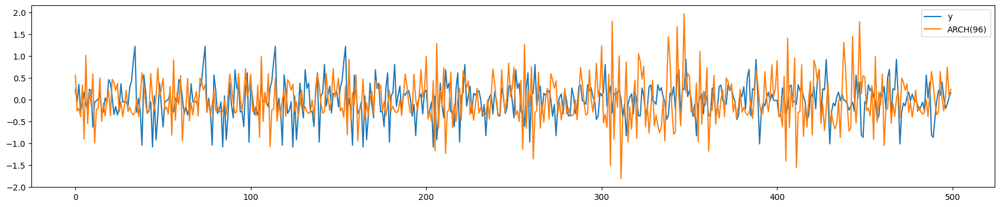

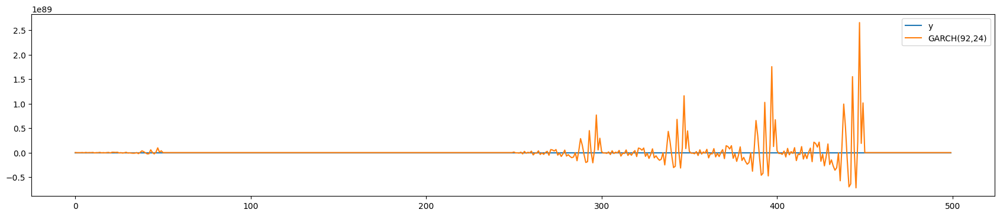

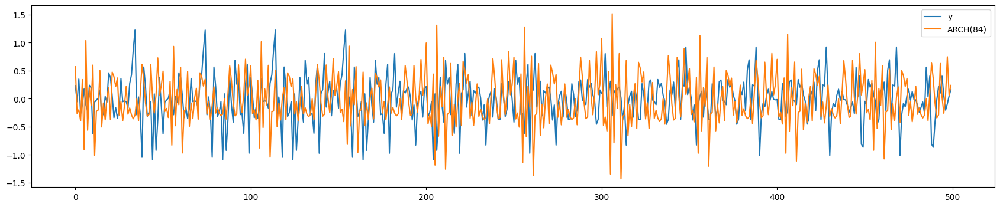

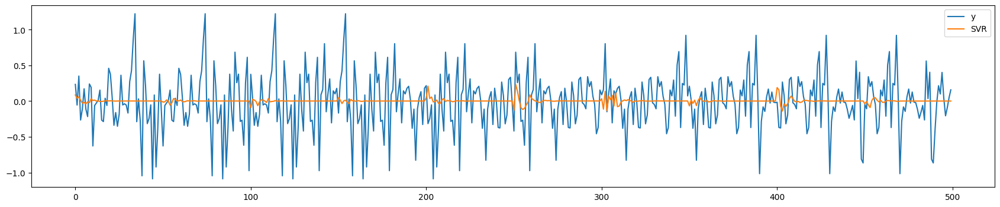

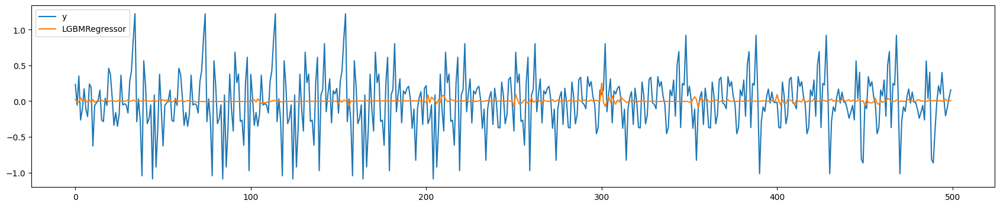

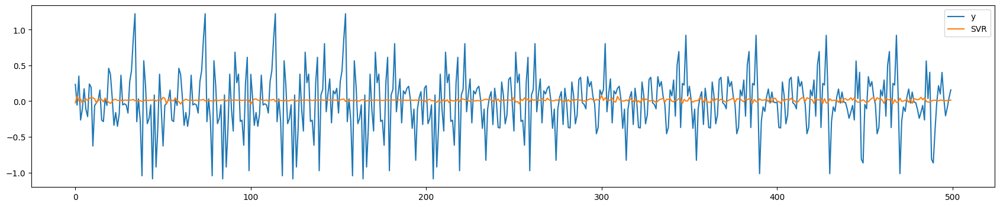

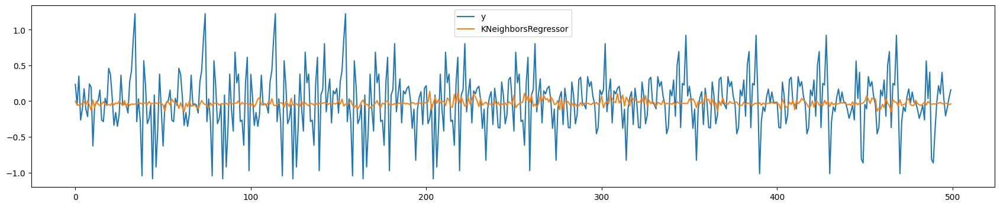

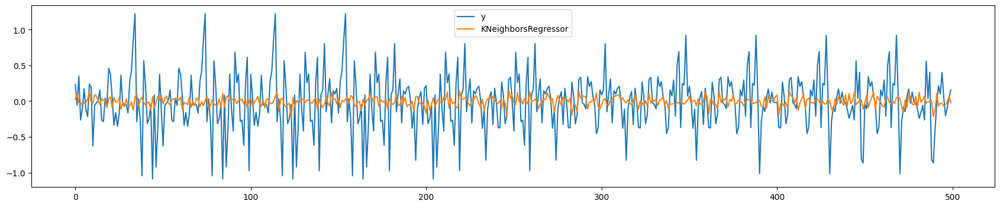

In [127]:
crossvalidate_model(sf_1, 5000)
crossvalidate_model(sf_2, 5000)
crossvalidate_model(sf_3, 5000)
crossvalidate_model(mlf_1, 5000)
crossvalidate_model(mlf_2, 5000)
crossvalidate_model(mlf_3, 5000)
crossvalidate_model(mlf_4, 5000)
crossvalidate_model(mlf_5, 5000)

### 1000 точек

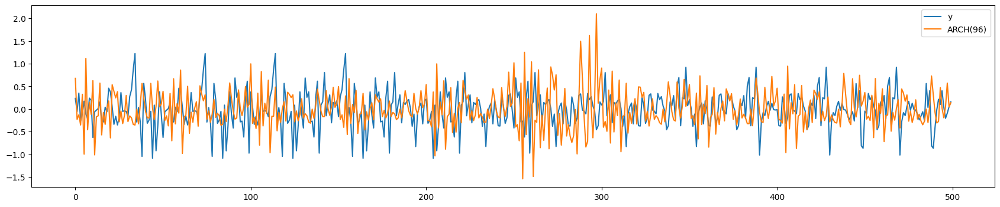

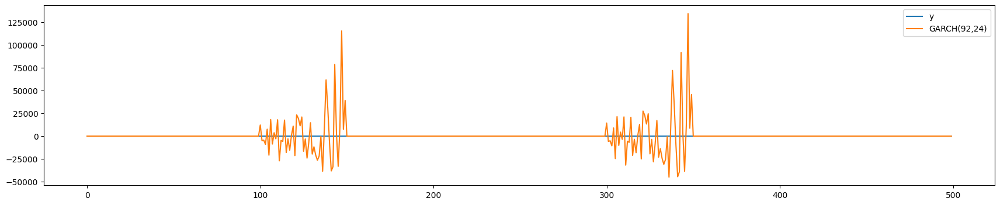

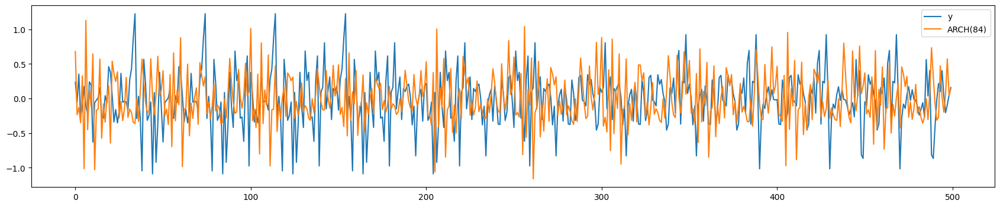

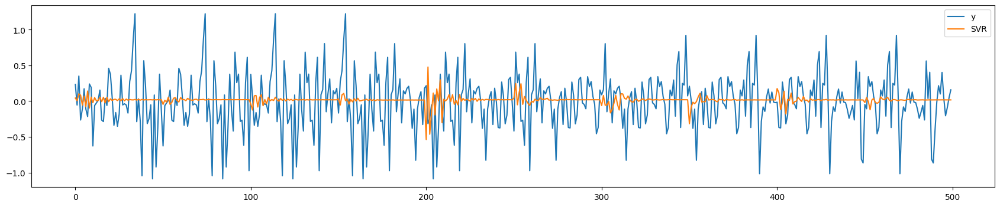

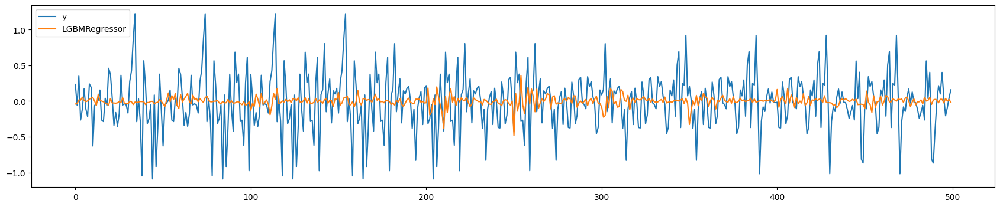

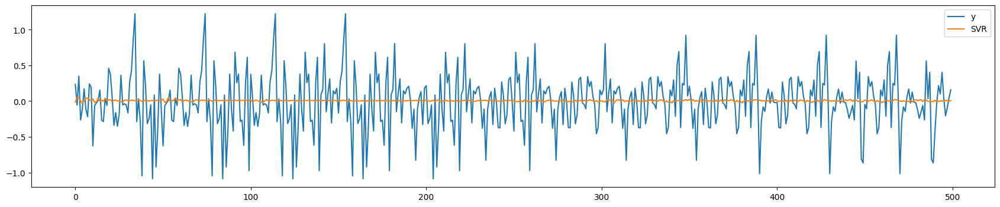

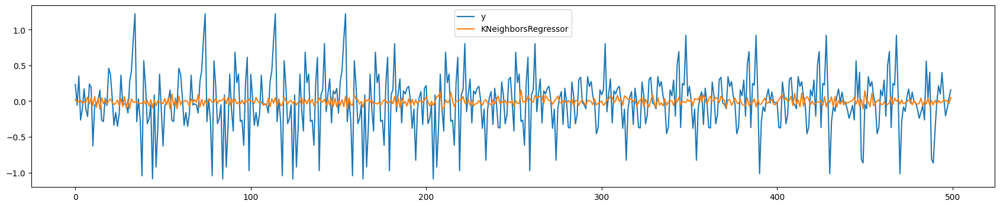

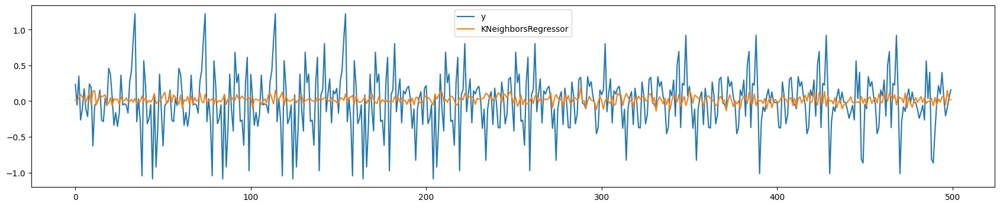

In [128]:
crossvalidate_model(sf_1, 1000)
crossvalidate_model(sf_2, 1000)
crossvalidate_model(sf_3, 1000)
crossvalidate_model(mlf_1, 1000)
crossvalidate_model(mlf_2, 1000)
crossvalidate_model(mlf_3, 1000)
crossvalidate_model(mlf_4, 1000)
crossvalidate_model(mlf_5, 1000)

### 300 точек

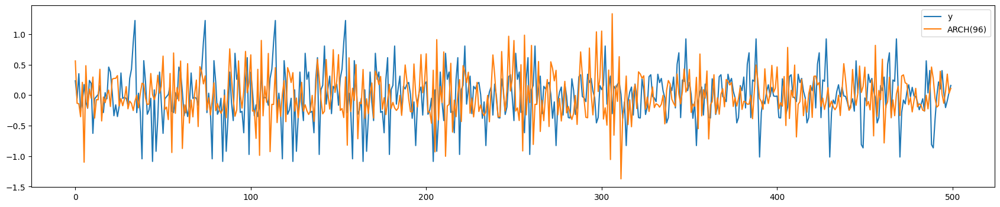

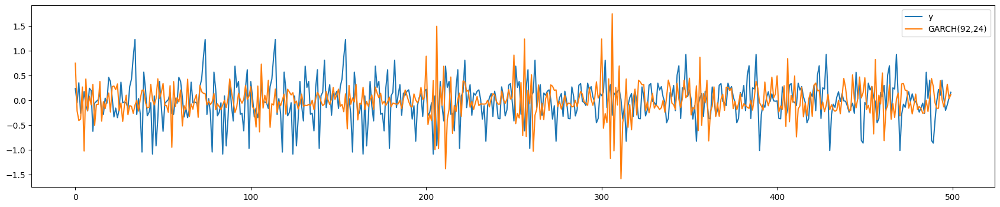

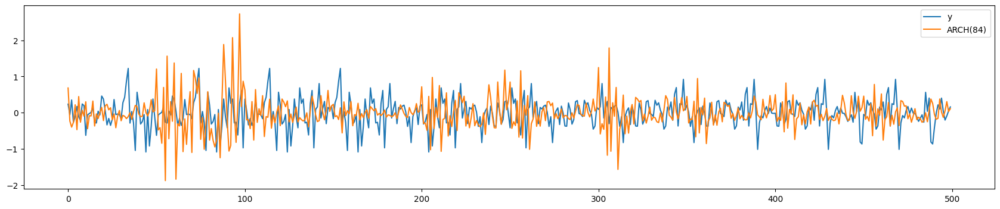

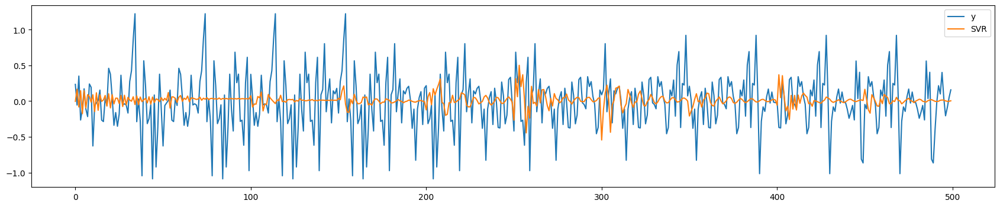

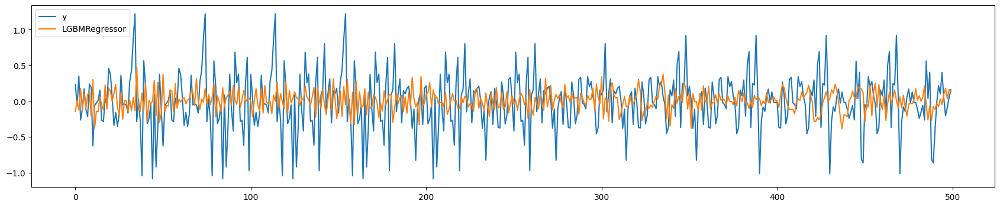

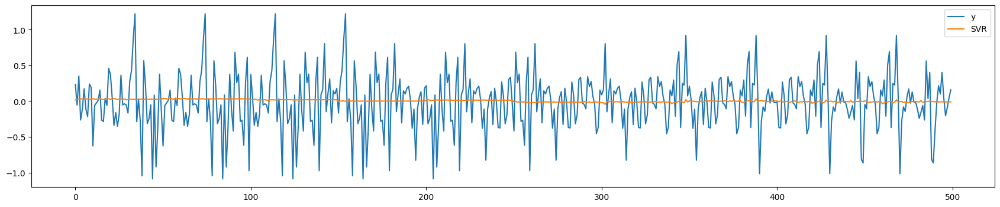

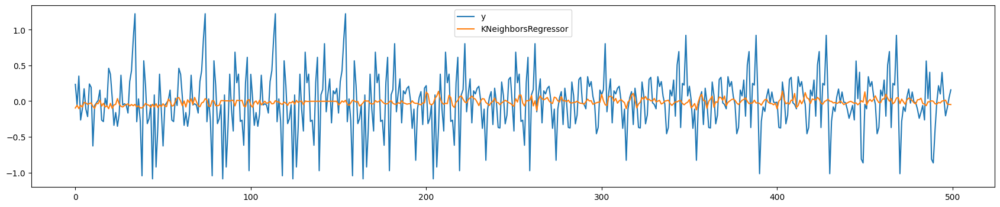

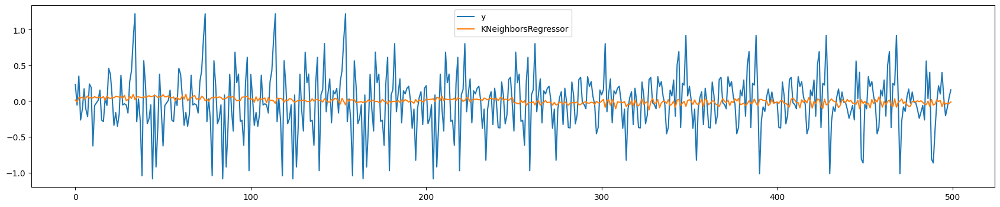

In [129]:
crossvalidate_model(sf_1, 300)
crossvalidate_model(sf_2, 300)
crossvalidate_model(sf_3, 300)
crossvalidate_model(mlf_1, 300)
crossvalidate_model(mlf_2, 300)
crossvalidate_model(mlf_3, 300)
crossvalidate_model(mlf_4, 300)
crossvalidate_model(mlf_5, 300)

## Вывод !TODO